# Gathering Data

In [1]:
import requests
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from ast import literal_eval
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics.pairwise import cosine_similarity
import re
import json
from deap import tools
from deap import base
import random
from deap import creator
from sklearn.preprocessing import MinMaxScaler
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from ultralytics import YOLO
from PIL import Image
import matplotlib.patches as patches
import random
from pathlib import Path
import os
from warnings import simplefilter

Type weakneses from [here](https://pokemondb.net/type)

In [2]:
type_weakness = {
    "normal": {"normal": 1, "fire": 1, "water": 1, "electric": 1, "grass": 1, "ice": 1, "fighting": 1, "poison": 1, "ground": 1, "flying": 1, "psychic": 1, "bug": 1, "rock": 0.5, "ghost": 0, "dragon": 1, "dark": 1, "steel": 0.5, "fairy": 1},
    "fire": {"normal": 1, "fire": 0.5, "water": 0.5, "electric": 1, "grass": 2, "ice": 2, "fighting": 1, "poison": 1, "ground": 1, "flying": 1, "psychic": 1, "bug": 2, "rock": 0.5, "ghost": 1, "dragon": 0.5, "dark": 1, "steel": 2, "fairy": 1},
    "water": {"normal": 1, "fire": 2, "water": 0.5, "electric": 1, "grass": 0.5, "ice": 1, "fighting": 1, "poison": 1, "ground": 2, "flying": 1, "psychic": 1, "bug": 1, "rock": 2, "ghost": 1, "dragon": 0.5, "dark": 1, "steel": 1, "fairy": 1},
    "electric": {"normal": 1, "fire": 1, "water": 2, "electric": 0.5, "grass": 0.5, "ice": 1, "fighting": 1, "poison": 1, "ground": 0, "flying": 2, "psychic": 1, "bug": 1, "rock": 1, "ghost": 1, "dragon": 0.5, "dark": 1, "steel": 1, "fairy": 1},
    "grass": {"normal": 1, "fire": 0.5, "water": 2, "electric": 1, "grass": 0.5, "ice": 1, "fighting": 1, "poison": 0.5, "ground": 2, "flying": 0.5, "psychic": 1, "bug": 0.5, "rock": 2, "ghost": 1, "dragon": 0.5, "dark": 1, "steel": 0.5, "fairy": 1},
    "ice": {"normal": 1, "fire": 0.5, "water": 0.5, "electric": 1, "grass": 2, "ice": 0.5, "fighting": 1, "poison": 1, "ground": 2, "flying": 2, "psychic": 1, "bug": 1, "rock": 1, "ghost": 1, "dragon": 2, "dark": 1, "steel": 0.5, "fairy": 1},
    "fighting": {"normal": 2, "fire": 1, "water": 1, "electric": 1, "grass": 1, "ice": 2, "fighting": 1, "poison": 0.5, "ground": 1, "flying": 0.5, "psychic": 0.5, "bug": 0.5, "rock": 2, "ghost": 0, "dragon": 1, "dark": 2, "steel": 2, "fairy": 0.5},
    "poison": {"normal": 1, "fire": 1, "water": 1, "electric": 1, "grass": 2, "ice": 1, "fighting": 1, "poison": 0.5, "ground": 0.5, "flying": 1, "psychic": 1, "bug": 1, "rock": 0.5, "ghost": 0.5, "dragon": 1, "dark": 1, "steel": 0, "fairy": 2},
    "ground": {"normal": 1, "fire": 2, "water": 1, "electric": 2, "grass": 0.5, "ice": 1, "fighting": 1, "poison": 2, "ground": 1, "flying": 0, "psychic": 1, "bug": 0.5, "rock": 2, "ghost": 1, "dragon": 1, "dark": 1, "steel": 2, "fairy": 1},
    "flying": {"normal": 1, "fire": 1, "water": 1, "electric": 0.5, "grass": 2, "ice": 1, "fighting": 2, "poison": 1, "ground": 1, "flying": 1, "psychic": 1, "bug": 2, "rock": 0.5, "ghost": 1, "dragon": 1, "dark": 1, "steel": 0.5, "fairy": 1},
    "psychic": {"normal": 1, "fire": 1, "water": 1, "electric": 1, "grass": 1, "ice": 1, "fighting": 2, "poison": 2, "ground": 1, "flying": 1, "psychic": 0.5, "bug": 1, "rock": 1, "ghost": 1, "dragon": 1, "dark": 0, "steel": 0.5, "fairy": 1},
    "bug": {"normal": 1, "fire": 0.5, "water": 1, "electric": 1, "grass": 2, "ice": 1, "fighting": 0.5, "poison": 0.5, "ground": 1, "flying": 0.5, "psychic": 2, "bug": 1, "rock": 1, "ghost": 0.5, "dragon": 1, "dark": 2, "steel": 0.5, "fairy": 0.5},
    "rock": {"normal": 1, "fire": 2, "water": 1, "electric": 1, "grass": 1, "ice": 2, "fighting": 0.5, "poison": 1, "ground": 0.5, "flying": 2, "psychic": 1, "bug": 2, "rock": 1, "ghost": 1, "dragon": 1, "dark": 1, "steel": 0.5, "fairy": 1},
    "ghost": {"normal": 0, "fire": 1, "water": 1, "electric": 1, "grass": 1, "ice": 1, "fighting": 1, "poison": 1, "ground": 1, "flying": 1, "psychic": 2, "bug": 1, "rock": 1, "ghost": 2, "dragon": 1, "dark": 0.5, "steel": 1, "fairy": 1},
    "dragon": {"normal": 1, "fire": 1, "water": 1, "electric": 1, "grass": 1, "ice": 1, "fighting": 1, "poison": 1, "ground": 1, "flying": 1, "psychic": 1, "bug": 1, "rock": 1, "ghost": 1, "dragon": 2, "dark": 1, "steel": 0.5, "fairy": 0},
    "dark": {"normal": 1, "fire": 1, "water": 1, "electric": 1, "grass": 1, "ice": 1, "fighting": 0.5, "poison": 1, "ground": 1, "flying": 1, "psychic": 2, "bug": 1, "rock": 1, "ghost": 2, "dragon": 1, "dark": 0.5, "steel": 1, "fairy": 0.5},
    "steel": {"normal": 1, "fire": 0.5, "water": 0.5, "electric": 0.5, "grass": 1, "ice": 2, "fighting": 1, "poison": 1, "ground": 1, "flying": 1, "psychic": 1, "bug": 1, "rock": 2, "ghost": 1, "dragon": 1, "dark": 1, "steel": 0.5, "fairy": 2},
    "fairy": {"normal": 1, "fire": 0.5, "water": 1, "electric": 1, "grass": 1, "ice": 1, "fighting": 2, "poison": 0.5, "ground": 1, "flying": 1, "psychic": 1, "bug": 1, "rock": 1, "ghost": 1, "dragon": 2, "dark": 2, "steel": 0.5, "fairy": 1}
}

In [ ]:
# Code from the example
def get_pokemon_name_stats_and_weaknesses(data):
    name = data["name"]
    
    # Sum all 6 stats
    stats_total = sum([data['stats'][i]['base_stat'] for i in range(6)])
    
    type1 = data['types'][0]['type']['name']
    
    # Get the weakness values for this Pokémon
    weakness = type_weakness[type1].copy()  # Start with primary type weaknesses
    
    # If it has a secondary type, multiply the weakness values
    if len(data['types']) > 1:
        type2 = data['types'][1]['type']['name']
        for type_name in weakness:
            weakness[type_name] *= type_weakness[type2][type_name]
    
    return name, stats_total, weakness

In [4]:
# Code to extract the individual stats to have more features in the dataset
def get_pokemon_individual_stats(data):
    return [data['stats'][i]['base_stat'] for i in range(6)]

def get_pokemon_type(data):
    return [data['types'][i]['type']['name'] for i in range(len(data['types']))]

In [ ]:
def get_all_pokemon():
    url = "https://pokeapi.co/api/v2/pokemon?limit=2000"
    names, stats_totals, weaknesses = [], [], []
    individual_stats = []
    types = []
    
    response = requests.get(url)
    all_pokemon = response.json()['results']
    total_count = len(all_pokemon)
    print(f"Total Pokémon: {total_count}")

    for i, pokemon in enumerate(all_pokemon):
        try:
            print(f"Processing Pokémon {i + 1}/{total_count}: {pokemon['name']}")
            response = requests.get(pokemon['url'])
            data = response.json()
            
            name, stats_total, weakness = get_pokemon_name_stats_and_weaknesses(data)
            names.append(name)
            stats_totals.append(stats_total)
            weaknesses.append(weakness)
            
            individual_stats.append(get_pokemon_individual_stats(data))
            types.append(get_pokemon_type(data))
        except Exception as e:
            print(f"Error processing {pokemon['name']}: {e}")
    
    return names, stats_totals, weaknesses, individual_stats, types


In [ ]:
names, stats_totals, weaknesses, individual_stats, types = get_all_pokemon()

In [10]:
out = pd.DataFrame()
out['name'] = names
out['stats_total'] = stats_totals
out['weakness'] = weaknesses
out['individual_stats'] = individual_stats
out['types'] = types
out.to_csv('new_data/pokemon_data.csv', index=False)

# Data Preprocessing

In [3]:
pk_df = pd.read_csv('new_data/pokemon_data_with_moveset.csv')
# Convert the string representations of lists back to actual lists, and the same for the weaknesses dictionary
pk_df['weakness'] = pk_df['weakness'].apply(literal_eval)
pk_df['individual_stats'] = pk_df['individual_stats'].apply(literal_eval)
pk_df['types'] = pk_df['types'].apply(literal_eval)

# Recommendation System

In [4]:
# I get a performance warning when I run this code, because the dataframe has 979 columns.
# I don't see any performance issues, so I will ignore the warning

simplefilter(action="ignore", category=pd.errors.PerformanceWarning)

def create_pokemon_feature_matrix(df, weights=None, path_to_move_data: str = "./new_data/moves_data.json"):
    if weights is None:
        weights = {
            'individual_stats': 0.3,
            'weakness': 0.3,
            'types': 0.4,
            'moveset': 0.5
        }
    
    # 1. Process moveset data (one-hot encoding)
    # Load moveset data
    with open(path_to_move_data, 'r') as f:
        move_names = set(json.load(f).keys()) # Should be unique, but I cast it as a set just in case

    move_features = pd.DataFrame(index=df.index)
    for move_name in sorted(move_names):
        move_features[f'move_{move_name}'] = df['moveset'].apply(
            lambda x: 1 if move_name in x else 0
        )
    # No need to normalize binary features   


    # 2. Process individual stats
    # Extract the individual stats and name them
    stat_names = ['hp', 'attack', 'defense', 'sp_attack', 'sp_defense', 'speed']
    stats_df = pd.DataFrame(df['individual_stats'].tolist(), 
                           columns=stat_names,
                           index=df.index)
    
    # Normalize stats
    scaler = MinMaxScaler()
    stats_normalized = pd.DataFrame(
        scaler.fit_transform(stats_df),
        columns=stats_df.columns,
        index=stats_df.index
    )
    
    # 3. Process weakness data
    # Extract all possible types from weakness dictionaries
    all_types = set()
    for weakness_dict in df['weakness']:
        all_types.update(weakness_dict.keys())
    
    # Create weakness features dataframe
    weakness_features = pd.DataFrame(index=df.index)
    for type_name in sorted(all_types):
        weakness_features[f'weakness_{type_name}'] = df['weakness'].apply(
            lambda x: x.get(type_name, 1.0)  # Default to 1.0 (neutral) if type not found
        )
    
    # Normalize weakness features
    weakness_normalized = pd.DataFrame(
        scaler.fit_transform(weakness_features),
        columns=weakness_features.columns,
        index=weakness_features.index
    )
    
    # 4. Process Pokemon types using one-hot encoding
    # Get all unique types
    all_pokemon_types = set()
    for types_list in df['types']:
        all_pokemon_types.update(types_list)
    
    # Create type features dataframe
    type_features = pd.DataFrame(index=df.index)
    for type_name in sorted(all_pokemon_types):
        type_features[f'type_{type_name}'] = df['types'].apply(
            lambda x: 1 if type_name in x else 0
        )
    
    # No need to normalize binary features
    
    # 5. Combine all features with their weights
    feature_groups = {
        'individual_stats': stats_normalized * weights['individual_stats'],
        'weakness': weakness_normalized * weights['weakness'],
        'types': type_features * weights['types'],
        'moveset': move_features * weights['moveset']
    }
    
    # Concatenate all feature groups
    combined_features = pd.concat(feature_groups.values(), axis=1)
    
    return combined_features

In [13]:
feature_matrix = create_pokemon_feature_matrix(pk_df)
feature_matrix.head()

,hp,attack,defense,sp_attack,sp_defense,speed,weakness_bug,weakness_dark,weakness_dragon,weakness_electric,...,move_work-up,move_worry-seed,move_wrap,move_wring-out,move_x-scissor,move_yawn,move_zap-cannon,move_zen-headbutt,move_zing-zap,move_zippy-zap
0,0.051969,0.071351,0.053878,0.089674,0.058696,0.061538,0.02,0.075,0.02,0.128571,...,0.5,0.5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.069685,0.092432,0.071020,0.114130,0.078261,0.084615,0.02,0.075,0.02,0.128571,...,0.5,0.5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.093307,0.124865,0.095510,0.146739,0.104348,0.115385,0.02,0.075,0.02,0.128571,...,0.5,0.5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.044882,0.076216,0.046531,0.081522,0.039130,0.092308,0.14,0.075,0.02,0.128571,...,0.5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.067323,0.095676,0.064898,0.114130,0.058696,0.115385,0.14,0.075,0.02,0.128571,...,0.5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [14]:
def get_variants_to_drop(df, column_name, chosen_name):
    """
    Get a set of variants to drop based on the chosen name. Used in next function, if drop_form_variants is True.
    """
    base_name = chosen_name.split('-')[0]  # e.g., 'pikachu' from 'pikachu-belle'
    pattern = re.compile(rf"^{re.escape(base_name)}(-[\w-]+)?$", re.IGNORECASE)
    
    to_drop = set(
        name for name in df[column_name]
        if pattern.match(name) and name != chosen_name
    )
    
    return to_drop

In [15]:
def get_pokemon_recommendations(name, df, feature_matrix=None, weights=None, top_n=10, drop_form_variants=False):
    if drop_form_variants:
        names_to_drop = get_variants_to_drop(df, 'name', name)
        df = df[~df['name'].isin(names_to_drop)]
        feature_matrix = create_pokemon_feature_matrix(df, weights) # If we drop form variants, we need to recalculate the feature matrix, so even if the argument is passed, we will recalculate it.
    # Create feature matrix if not provided
    if feature_matrix is None:
        feature_matrix = create_pokemon_feature_matrix(df, weights)
    
    # Same as in assignment, create a reverse index map, to find the index of the pokemon by passing their name
    indices = pd.Series(df.index, index=df['name']).drop_duplicates()
    idx = indices[name]
    
    # Calculate similarity scores
    cosine_sim = cosine_similarity(feature_matrix, feature_matrix)
    
    # Get similarity scores, also basically the same as in assignment
    sim_scores = list(enumerate(cosine_sim[idx]))
    # Sort by the similarity score in descending order
    sim_scores = sorted(sim_scores, key=lambda x: x[1], reverse=True)
    # Get the n most similar pokemon, excluding the pokemon itself
    sim_scores = sim_scores[1:top_n+1]
    # Get the indices of the most similar pokemon, because we will be returning a slice of the original dataframe
    pokemon_indices = [i[0] for i in sim_scores]
    
    # Get recommendations
    recommendations = df.iloc[pokemon_indices].copy()
    recommendations['similarity_score'] = [i[1] for i in sim_scores]
    
    return recommendations

In [34]:
weights = {
            'individual_stats': 0.6,
            'weakness': 0.6,
            'types': 0.3,
            'moveset': 0.4
        }
get_pokemon_recommendations('pikachu', pk_df, top_n=10, weights=weights)

,name,stats_total,weakness,individual_stats,types,moveset,similarity_score
25,raichu,485,"{'normal': 1, 'fire': 1, 'water': 2, 'electric...","[60, 90, 55, 90, 80, 110]",[electric],"['mega-punch', 'pay-day', 'thunder-punch', 'sl...",0.950798
1118,pikachu-original-cap,320,"{'normal': 1, 'fire': 1, 'water': 2, 'electric...","[35, 55, 40, 50, 50, 90]",[electric],"['mega-punch', 'pay-day', 'thunder-punch', 'sl...",0.871430
1119,pikachu-hoenn-cap,320,"{'normal': 1, 'fire': 1, 'water': 2, 'electric...","[35, 55, 40, 50, 50, 90]",[electric],"['mega-punch', 'pay-day', 'thunder-punch', 'sl...",0.871430
1121,pikachu-unova-cap,320,"{'normal': 1, 'fire': 1, 'water': 2, 'electric...","[35, 55, 40, 50, 50, 90]",[electric],"['mega-punch', 'pay-day', 'thunder-punch', 'sl...",0.871430
1123,pikachu-alola-cap,320,"{'normal': 1, 'fire': 1, 'water': 2, 'electric...","[35, 55, 40, 50, 50, 90]",[electric],"['mega-punch', 'pay-day', 'thunder-punch', 'sl...",0.871430
1172,pikachu-partner-cap,320,"{'normal': 1, 'fire': 1, 'water': 2, 'electric...","[35, 55, 40, 50, 50, 90]",[electric],"['mega-punch', 'pay-day', 'thunder-punch', 'sl...",0.871430
1122,pikachu-kalos-cap,320,"{'normal': 1, 'fire': 1, 'water': 2, 'electric...","[35, 55, 40, 50, 50, 90]",[electric],"['mega-punch', 'pay-day', 'thunder-punch', 'sl...",0.843748
171,pichu,205,"{'normal': 1, 'fire': 1, 'water': 2, 'electric...","[20, 40, 15, 35, 35, 60]",[electric],"['double-slap', 'mega-punch', 'thunder-punch',...",0.827931
1120,pikachu-sinnoh-cap,320,"{'normal': 1, 'fire': 1, 'water': 2, 'electric...","[35, 55, 40, 50, 50, 90]",[electric],"['mega-punch', 'pay-day', 'thunder-punch', 'sl...",0.825449
310,plusle,405,"{'normal': 1, 'fire': 1, 'water': 2, 'electric...","[60, 50, 40, 85, 75, 95]",[electric],"['mega-punch', 'thunder-punch', 'mega-kick', '...",0.793728


This returns a lot of variants of pikachu, which might not be what the user wants, so I have added an extra parameter to drop these variants.

In [35]:
get_pokemon_recommendations('pikachu', pk_df, top_n=10, drop_form_variants=True, weights=weights)

,name,stats_total,weakness,individual_stats,types,moveset,similarity_score
25,raichu,485,"{'normal': 1, 'fire': 1, 'water': 2, 'electric...","[60, 90, 55, 90, 80, 110]",[electric],"['mega-punch', 'pay-day', 'thunder-punch', 'sl...",0.950798
171,pichu,205,"{'normal': 1, 'fire': 1, 'water': 2, 'electric...","[20, 40, 15, 35, 35, 60]",[electric],"['double-slap', 'mega-punch', 'thunder-punch',...",0.827931
310,plusle,405,"{'normal': 1, 'fire': 1, 'water': 2, 'electric...","[60, 50, 40, 85, 75, 95]",[electric],"['mega-punch', 'thunder-punch', 'mega-kick', '...",0.793728
311,minun,405,"{'normal': 1, 'fire': 1, 'water': 2, 'electric...","[60, 40, 50, 75, 85, 95]",[electric],"['mega-punch', 'thunder-punch', 'mega-kick', '...",0.792429
1124,raichu-alola,485,"{'normal': 1, 'fire': 1, 'water': 2, 'electric...","[60, 85, 50, 95, 85, 110]","[electric, psychic]","['mega-punch', 'pay-day', 'thunder-punch', 'sl...",0.787094
124,electabuzz,490,"{'normal': 1, 'fire': 1, 'water': 2, 'electric...","[65, 83, 57, 95, 85, 105]",[electric],"['mega-punch', 'fire-punch', 'ice-punch', 'thu...",0.761954
134,jolteon,525,"{'normal': 1, 'fire': 1, 'water': 2, 'electric...","[65, 65, 60, 110, 95, 130]",[electric],"['pay-day', 'double-kick', 'sand-attack', 'hea...",0.753949
179,flaaffy,365,"{'normal': 1, 'fire': 1, 'water': 2, 'electric...","[70, 55, 55, 80, 60, 45]",[electric],"['mega-punch', 'fire-punch', 'ice-punch', 'thu...",0.750622
238,elekid,360,"{'normal': 1, 'fire': 1, 'water': 2, 'electric...","[45, 63, 37, 65, 55, 95]",[electric],"['karate-chop', 'mega-punch', 'fire-punch', 'i...",0.725754
416,pachirisu,405,"{'normal': 1, 'fire': 1, 'water': 2, 'electric...","[60, 45, 70, 45, 90, 95]",[electric],"['thunder-punch', 'cut', 'headbutt', 'take-dow...",0.723572


## Genetic Algorithm I

In [24]:
def create_individual(pk_df):
    """
    Create a random individual for the genetic algorithm.
    
    Parameters:
    -----------
    pk_df : pandas DataFrame
        DataFrame containing Pokemon data
    
    Returns:
    --------
    individual : list
        List of selected Pokemon names
    """
    # Randomly select 6 unique Pokemon from the DataFrame
    selected_pokemon = np.random.choice(pk_df['name'], size=6, replace=False)
    
    return list(selected_pokemon)


In [25]:
pk_df.head()

,name,stats_total,weakness,individual_stats,types,moveset
0,bulbasaur,318,"{'normal': 1, 'fire': 0.5, 'water': 2, 'electr...","[45, 49, 49, 65, 65, 45]","[grass, poison]","['razor-wind', 'swords-dance', 'cut', 'bind', ..."
1,ivysaur,405,"{'normal': 1, 'fire': 0.5, 'water': 2, 'electr...","[60, 62, 63, 80, 80, 60]","[grass, poison]","['swords-dance', 'cut', 'bind', 'vine-whip', '..."
2,venusaur,525,"{'normal': 1, 'fire': 0.5, 'water': 2, 'electr...","[80, 82, 83, 100, 100, 80]","[grass, poison]","['swords-dance', 'cut', 'bind', 'vine-whip', '..."
3,charmander,309,"{'normal': 1, 'fire': 0.5, 'water': 0.5, 'elec...","[39, 52, 43, 60, 50, 65]",[fire],"['mega-punch', 'fire-punch', 'thunder-punch', ..."
4,charmeleon,405,"{'normal': 1, 'fire': 0.5, 'water': 0.5, 'elec...","[58, 64, 58, 80, 65, 80]",[fire],"['mega-punch', 'fire-punch', 'thunder-punch', ..."


In [ ]:
def fitness_function(individual_group): # individual_group is a list of 6 pokemon names
    """
    Calculates the fitness of a Pokemon team (list of names).
    Higher fitness is better.
    - Rewards higher total base stats.
    - Penalizes shared types (promotes type diversity).
    - Penalizes number of weaknesses (promotes defensive coverage).
    - Ensures the team is valid (6 unique Pokemon found).
    """
    # --- Validation ---
    if len(individual_group) != 6 or len(set(individual_group)) != 6:
        # Penalize invalid teams (wrong size or duplicates)
        return -float('inf'), # Must return a tuple

    # --- Data Fetching ---
    # Use .loc for potentially faster access if name were index, but isin is fine
    team_data = pk_df[pk_df['name'].isin(individual_group)]

    # Check if all pokemon were found
    if len(team_data) != 6:
         # print(f"Warning: Could not find all Pokemon for team: {individual_group}. Found: {team_data['name'].tolist()}")
         # Assign a very low fitness if the team is invalid
         return -float('inf'), # Must return a tuple

    # --- Calculate Fitness Components ---
    total_base_stats = team_data['stats_total'].sum()

    # --- Weakness Penalty ---
    # Calculate total number of 2x or 4x weaknesses across the team
    total_weaknesses_count = 0
    for weakness_dict in team_data['weakness']:
        # Count weaknesses >= 2x
        count = sum(1 for multiplier in weakness_dict.values() if multiplier >= 2)
        total_weaknesses_count += count
    weakness_penalty = total_weaknesses_count * 20

    # --- Type Diversity Score ---
    all_types = []
    for types_list in team_data['types']:
        all_types.extend(types_list)
    num_unique_types = len(set(all_types))

    type_diversity_score = num_unique_types * 30

    # --- Combine Scores ---
    # Example: Maximize stats and diversity, minimize weakness penalty
    final_fitness = total_base_stats + type_diversity_score - weakness_penalty

    # Return the final fitness score as a tuple
    return final_fitness,

In [28]:
def mutate_individual(individual):
    """
    Mutate an individual by randomly changing one Pokemon.
    
    Parameters:
    -----------
    individual : list
        List of selected Pokemon names
    
    Returns:
    --------
    mutated_individual : list
        Mutated individual
    """


    # Randomly select an index to mutate
    index_to_mutate = np.random.randint(0, len(individual))
    
    # Randomly select a new Pokemon to replace the old one
    new_pokemon = np.random.choice(pk_df['name'], size=1)[0]
    
    # Replace the old Pokemon with the new one
    individual[index_to_mutate] = new_pokemon
    
    return individual

In [ ]:
creator.create("FitnessMax", base.Fitness, weights=(1.0,))
creator.create("Individual", list, fitness=creator.FitnessMax)
toolbox = base.Toolbox()
toolbox.register("attribute", create_individual, pk_df=pk_df)
toolbox.register("individual", tools.initIterate, creator.Individual, toolbox.attribute)
toolbox.register("population", tools.initRepeat, list, toolbox.individual)

toolbox.register("mate", tools.cxTwoPoint)
toolbox.register("mutate", mutate_individual)
toolbox.register("select", tools.selTournament, tournsize=3)
toolbox.register("evaluate", fitness_function)

In [31]:
pop = toolbox.population(n=50)
CXPB, MUTPB, NGEN = 0.5, 0.2, 800

fitnesses = map(toolbox.evaluate, pop)
for ind, fit in zip(pop, fitnesses):
    ind.fitness.values = fit

for generation in range(NGEN):
    offspring = toolbox.select(pop, len(pop))
    offspring = list(map(toolbox.clone, offspring))

    for child1, child2 in zip(offspring[::2], offspring[1::2]):
        if random.random() < CXPB:
            toolbox.mate(child1, child2)
            del child1.fitness.values
            del child2.fitness.values
    
    for mutant in offspring:
        if random.random() < MUTPB:
            toolbox.mutate(mutant)
            del mutant.fitness.values
    
    invalid_ind = [ind for ind in offspring if not ind.fitness.valid]
    fitnesses = map(toolbox.evaluate, invalid_ind)
    for ind, fit in zip(invalid_ind, fitnesses):
        ind.fitness.values = fit
    
    pop[:] = offspring

In [95]:
print("Best individual is: ", tools.selBest(pop, 1)[0])

Best individual is:  ['eternatus-eternamax', 'mewtwo-mega-y', 'arceus', 'groudon-primal', 'kyogre-primal', 'rayquaza-mega']


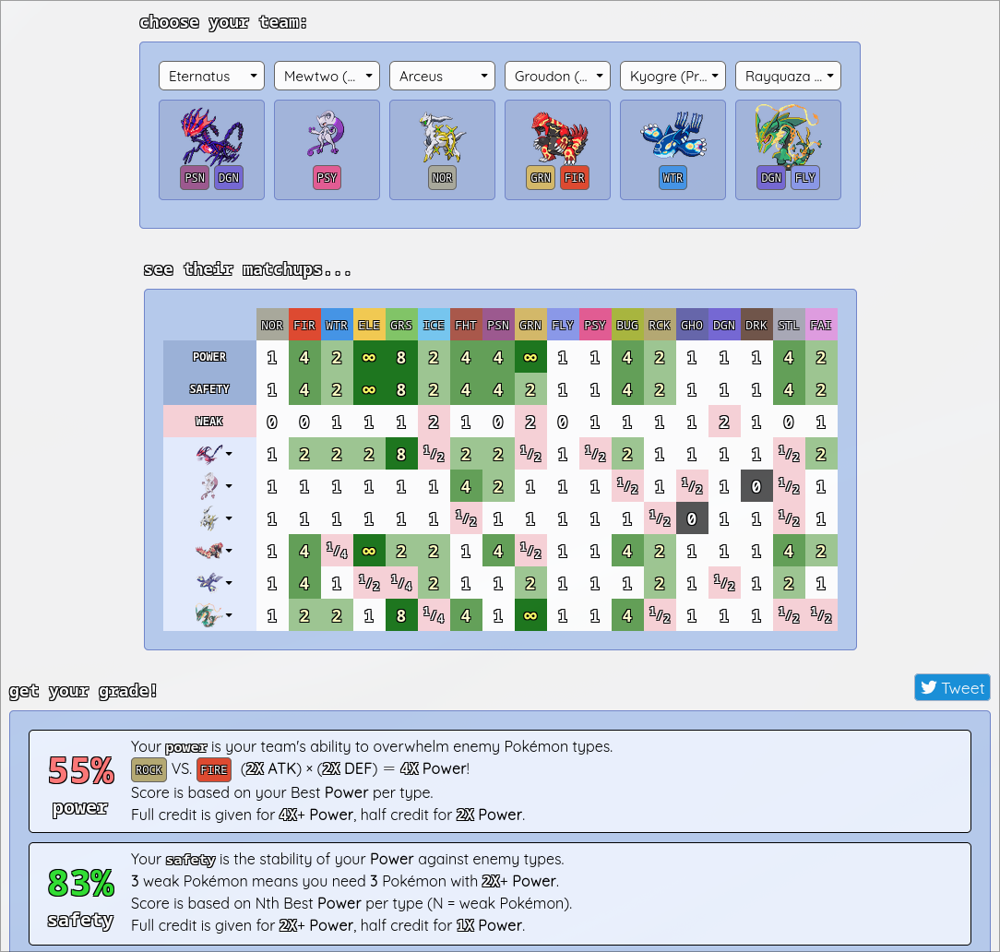


The teams are always more safe than powerful. <font color='red'> But this is not the final form of the genetic algorithm.

# Adding Movesets to Pokemon

In [6]:
BASE_URL_POKEMON = "https://pokeapi.co/api/v2/pokemon/"

def get_moveset(pokemon_name):
    """
    Fetches the moveset for a given Pokémon name.
    
    Parameters:
    -----------
    pokemon_name : str
        Name of the Pokémon
    
    Returns:
    --------
    moveset : list
        List of moves available for the Pokémon
    """
    url = f"{BASE_URL_POKEMON}{pokemon_name}"
    response = requests.get(url)
    
    if response.status_code == 200:
        data = response.json()
        moves = [move['move']['name'] for move in data['moves']]
        return moves
    else:
        print(f"Error fetching data for {pokemon_name}: {response.status_code}")
        return []

In [7]:
BASE_URL_MOVE = "https://pokeapi.co/api/v2/move/"

def get_move_deets(move_url):

    response = requests.get(move_url)
    
    if response.status_code == 200:
        response = response.json()
        move_details = {
            "name": response['name'],
            "power": response['power'],
            "accuracy": response['accuracy'],
            "pp": response['pp'],
            "type": response['type']['name'],
            "meta": response['meta']
        }
    else:
        print(f"Error fetching data for {move_url}: {response.status_code}")
        return {}
    
    return move_details

In [8]:
def get_all_moves():
    url = "https://pokeapi.co/api/v2/move?limit=2000" # Only 937 moves in total
    moves_data = {}

    response = requests.get(url)
    all_moves = response.json()['results']

    for move in all_moves:
        move_name = move['name']
        move_url = move['url']
        move_details = get_move_deets(move_url)
        moves_data[move_name] = move_details
        print(f"Processed move: {move_name}")

    return moves_data

First, I got all the moves, because some are shared among pokemon

In [ ]:
all_moves = get_all_moves()

In [ ]:
print(all_moves['tackle']) # For example, to see the details of the move 'tackle'

{'name': 'tackle', 'power': 40, 'accuracy': 100, 'pp': 35, 'type': 'normal', 'meta': {'ailment': {'name': 'none', 'url': 'https://pokeapi.co/api/v2/move-ailment/0/'}, 'ailment_chance': 0, 'category': {'name': 'damage', 'url': 'https://pokeapi.co/api/v2/move-category/0/'}, 'crit_rate': 0, 'drain': 0, 'flinch_chance': 0, 'healing': 0, 'max_hits': None, 'max_turns': None, 'min_hits': None, 'min_turns': None, 'stat_chance': 0}}


In [10]:
with open('new_data/moves_data.json', 'w') as f:
    json.dump(all_moves, f, indent=4)

Then, go through all pokemon, and get their movesets

In [110]:
# Add a new column to the dataframe with the moveset
pk_df['moveset'] = pk_df['name'].apply(get_moveset)

In [112]:
pk_df.to_csv('new_data/pokemon_data_with_moveset.csv', index=False)

# Genetic Algorithm Part II

## 1. Scale the `stats_total`

In [32]:
pk_df.head()

,name,stats_total,weakness,individual_stats,types,moveset
0,bulbasaur,318,"{'normal': 1, 'fire': 0.5, 'water': 2, 'electr...","[45, 49, 49, 65, 65, 45]","[grass, poison]","['razor-wind', 'swords-dance', 'cut', 'bind', ..."
1,ivysaur,405,"{'normal': 1, 'fire': 0.5, 'water': 2, 'electr...","[60, 62, 63, 80, 80, 60]","[grass, poison]","['swords-dance', 'cut', 'bind', 'vine-whip', '..."
2,venusaur,525,"{'normal': 1, 'fire': 0.5, 'water': 2, 'electr...","[80, 82, 83, 100, 100, 80]","[grass, poison]","['swords-dance', 'cut', 'bind', 'vine-whip', '..."
3,charmander,309,"{'normal': 1, 'fire': 0.5, 'water': 0.5, 'elec...","[39, 52, 43, 60, 50, 65]",[fire],"['mega-punch', 'fire-punch', 'thunder-punch', ..."
4,charmeleon,405,"{'normal': 1, 'fire': 0.5, 'water': 0.5, 'elec...","[58, 64, 58, 80, 65, 80]",[fire],"['mega-punch', 'fire-punch', 'thunder-punch', ..."


In [7]:
pk_df['scaled_stats_total'] = MinMaxScaler().fit_transform(pk_df[['stats_total']])

In [8]:
pk_df.head()

,name,stats_total,weakness,individual_stats,types,moveset,scaled_stats_total
0,bulbasaur,318,"{'normal': 1, 'fire': 0.5, 'water': 2, 'electr...","[45, 49, 49, 65, 65, 45]","[grass, poison]","['razor-wind', 'swords-dance', 'cut', 'bind', ...",0.150526
1,ivysaur,405,"{'normal': 1, 'fire': 0.5, 'water': 2, 'electr...","[60, 62, 63, 80, 80, 60]","[grass, poison]","['swords-dance', 'cut', 'bind', 'vine-whip', '...",0.242105
2,venusaur,525,"{'normal': 1, 'fire': 0.5, 'water': 2, 'electr...","[80, 82, 83, 100, 100, 80]","[grass, poison]","['swords-dance', 'cut', 'bind', 'vine-whip', '...",0.368421
3,charmander,309,"{'normal': 1, 'fire': 0.5, 'water': 0.5, 'elec...","[39, 52, 43, 60, 50, 65]",[fire],"['mega-punch', 'fire-punch', 'thunder-punch', ...",0.141053
4,charmeleon,405,"{'normal': 1, 'fire': 0.5, 'water': 0.5, 'elec...","[58, 64, 58, 80, 65, 80]",[fire],"['mega-punch', 'fire-punch', 'thunder-punch', ...",0.242105


## 2. Define fitness function

The fitness function covers 5 aspects of the team:

1. Base stats - the `scaled_stats_total` column, which defines the raw power each pokemon has. This is good for attack, but it is by no means the only metric to look at when building a deck. For example, there are support pokemon that have bad power stats, but are good at boosting other pokemon on the team, or defending against enemy attacks.

2. Weaknesses - each pokemon type has types that it matches up against well, and types that it matches up against poorly. We want to have a team that covers a wide range of pokemon types for versitility. This metric covers only the bad matchups (types that our team's pokemon have 2x damage received multipliers for). In the code, I use a quadratic penalty for having multiple pokemon that have the 2x damage received multiplier for the same type.

3. Resistances - each type of pokemon is also resistant (0.5x damage taken), or even immune (0x damage taken) against certain kinds of pokemon. This is what this weight is responsible for.

4. Offensive Coverage - we want to have a wide array of offensive moves that we can choose from, since we don't know what kinds of pokemon we'll be fighting against.

5. STAB (Same-type attack bonus) power - attacks have the same types as pokemon, but a pokemon does not necessarily need to have an attack ability that is the same type as that pokemon. If it does, however, the move's damage is increased by 1.5x.

In [37]:
def calculate_team_fitness(individual_group, pk_df, all_moves, all_types):
    """
    Calculates the fitness of a Pokémon team (list of names).
    Higher fitness is better. Incorporates stats, defensive synergy,
    offensive coverage, and STAB power.
    """
    # --- Validation ---
    if len(individual_group) != 6 or len(set(individual_group)) != 6:
        return -float('inf'),  # Invalid team size or duplicates

    team_data = pk_df[pk_df['name'].isin(individual_group)].reset_index(drop=True)

    if len(team_data) != 6:
        # print(f"Warning: Could not find all Pokemon for team: {individual_group}.")
        return -float('inf'), # Could not find all specified Pokemon

    # --- 1. Base Stats Score ---
    total_base_stats = team_data['scaled_stats_total'].sum()
    stats_score = W_STATS * total_base_stats

    # --- 2. Defensive Synergy Score ---
    # Penalize shared weaknesses, reward resistances/immunities
    total_weakness_penalty_score = 0
    total_resistance_reward_score = 0

    for attacking_type in all_types:
        weakness_count = 0
        resistance_count = 0
        immunity_count = 0
        for i in range(6):
            multiplier = team_data.loc[i, 'weakness'].get(attacking_type, 1.0)
            if multiplier >= 2.0:
                weakness_count += 1
            elif multiplier == 0.0:
                immunity_count += 1
            elif multiplier <= 0.5:
                resistance_count += 1

        # Penalize more heavily if multiple Pokemon share the same weakness
        if weakness_count >= 2:
             total_weakness_penalty_score += weakness_count * weakness_count # Quadratic penalty for shared weaknesses

        # Reward resistances and especially immunities
        total_resistance_reward_score += (resistance_count * 1.0) + (immunity_count * 2.0) # Immunities worth more

    defensive_score = (W_WEAKNESS * total_weakness_penalty_score) + (W_RESISTANCE * total_resistance_reward_score)


    # --- 3. Offensive Coverage Score (Move Types) ---
    team_move_types = set()
    total_stab_power = 0

    for i in range(6):
        pokemon_types = set(team_data.loc[i, 'types'])
        pokemon_moves = team_data.loc[i, 'moveset']
        best_stab_power = 0

        for move_name in pokemon_moves:
            move_details = all_moves.get(move_name)
            if move_details and move_details.get('power') is not None: # Check if move exists and has power
                move_type = move_details['type']
                move_power = move_details['power']

                team_move_types.add(move_type) # Add type to team's offensive coverage set

                # Check for STAB
                if move_type in pokemon_types:
                    if move_power > best_stab_power:
                        best_stab_power = move_power

        total_stab_power += best_stab_power

    offensive_coverage_score = W_OFF_COVERAGE * len(team_move_types)
    stab_power_score = W_STAB_POWER * total_stab_power

    # --- 4. Combine Scores ---
    final_fitness = stats_score + defensive_score + offensive_coverage_score + stab_power_score

    # --- Return fitness tuple ---
    return final_fitness,

In [ ]:
W_STATS = 10.0       # Weight for total base stats
W_WEAKNESS = -7  # Penalty weight for shared weaknesses (negative because higher score is worse)
W_RESISTANCE = 7 # Reward weight for resistances/immunities
W_OFF_COVERAGE = 3.0 # Reward weight for offensive move type diversity
W_STAB_POWER = 1    # Reward weight for STAB move power
POPULATION_SIZE = 100 # Population size
CXPB, MUTPB, NGEN = 0.7, 1/POPULATION_SIZE, 800 # Crossover probability, mutation probability, number of generations


creator.create("FitnessMax", base.Fitness, weights=(1.0,))
creator.create("Individual", list, fitness=creator.FitnessMax)
toolbox = base.Toolbox()
toolbox.register("attribute", create_individual, pk_df=pk_df)
toolbox.register("individual", tools.initIterate, creator.Individual, toolbox.attribute)
toolbox.register("population", tools.initRepeat, list, toolbox.individual)

toolbox.register("mate", tools.cxTwoPoint)
toolbox.register("mutate", mutate_individual)
toolbox.register("select", tools.selTournament, tournsize=3)
toolbox.register("evaluate", calculate_team_fitness, pk_df=pk_df, all_moves=all_moves, all_types=all_possible_types)

pop = toolbox.population(n=POPULATION_SIZE)


fitnesses = map(toolbox.evaluate, pop)
for ind, fit in zip(pop, fitnesses):
    ind.fitness.values = fit

for generation in range(NGEN):
    offspring = toolbox.select(pop, len(pop))
    offspring = list(map(toolbox.clone, offspring))

    for child1, child2 in zip(offspring[::2], offspring[1::2]):
        if random.random() < CXPB:
            toolbox.mate(child1, child2)
            del child1.fitness.values
            del child2.fitness.values
    
    for mutant in offspring:
        if random.random() < MUTPB:
            toolbox.mutate(mutant)
            del mutant.fitness.values
    
    invalid_ind = [ind for ind in offspring if not ind.fitness.valid]
    fitnesses = map(toolbox.evaluate, invalid_ind)
    for ind, fit in zip(invalid_ind, fitnesses):
        ind.fitness.values = fit
    
    pop[:] = offspring

In [ ]:
print("Best individual is: ", tools.selBest(pop, 1)[0])
with open('results/pokemon_teams.csv', 'a') as f:
    f.write(f"{tools.selBest(pop, 1)[0]};{W_STATS};{W_WEAKNESS};{W_RESISTANCE};{W_OFF_COVERAGE};{W_STAB_POWER}\n")

Best individual is:  ['decidueye-hisui', 'dragalge', 'indeedee-female', 'nidoking', 'zoroark-hisui', 'terapagos-terastal']


## Team Evaluation

In [9]:
team_stats = pd.read_csv('results/pokemon_teams.csv', delimiter=';')
team_stats['team'] = team_stats['team'].apply(literal_eval)
team_stats.head()

,team,stats_weight,weaknesses_weight,resistance_weight,offensive_coverage_weight,stab_power_weight,power_percentage,safety_percentage
0,"[cyclizar, zarude-dada, wyrdeer, rotom-frost, ...",5.0,-10,7,5.0,1,88,86
1,"[dolliv, obstagoon, dragalge, meloetta-aria, l...",10.0,-10,7,5.0,1,86,91
2,"[clodsire, rotom-mow, rotom-frost, blaziken-me...",10.0,-10,7,5.0,1,88,97
3,"[nidoking, arctozolt, annihilape, meloetta-ari...",10.0,-10,7,5.0,1,83,88
4,"[wyrdeer, zoroark-hisui, zamazenta-crowned, ar...",10.0,-10,7,5.0,1,72,83


In [44]:
fig = make_subplots(rows=2, cols=2, subplot_titles=("Power Percentage", "Safety Percentage", "Power vs Safety"), specs=[[{}, {}],
           [{"colspan": 2}, None]])  
fig.add_trace(
    px.histogram(team_stats, x='power_percentage', nbins=20).data[0],
    row=1, col=1
)

fig.add_trace(
    px.histogram(team_stats, x='safety_percentage', nbins=20).data[0],
    row=1, col=2
)
fig.add_trace(
    px.scatter(team_stats, x='safety_percentage', y='power_percentage').data[0],
    row=2, col=1
)
fig.update_xaxes(title_text="Power Percentage", row=1, col=1)
fig.update_xaxes(title_text="Safety Percentage", row=1, col=2)
fig.update_yaxes(title_text="Count", row=1, col=1)
fig.update_yaxes(title_text="Count", row=1, col=2)
fig.update_yaxes(title_text="Power Percentage", row=2, col=1)
fig.update_xaxes(title_text="Safety Percentage", row=2, col=1)
fig.update_layout(height=1000, template='plotly_dark', title_text="Team Performance Analysis", title_font_size=32, title_x=0.5)
fig.update_traces(marker_color='#FF5733', row=1, col=1)
fig.update_traces(marker_color='#33FF57', row=1, col=2)
fig.show()

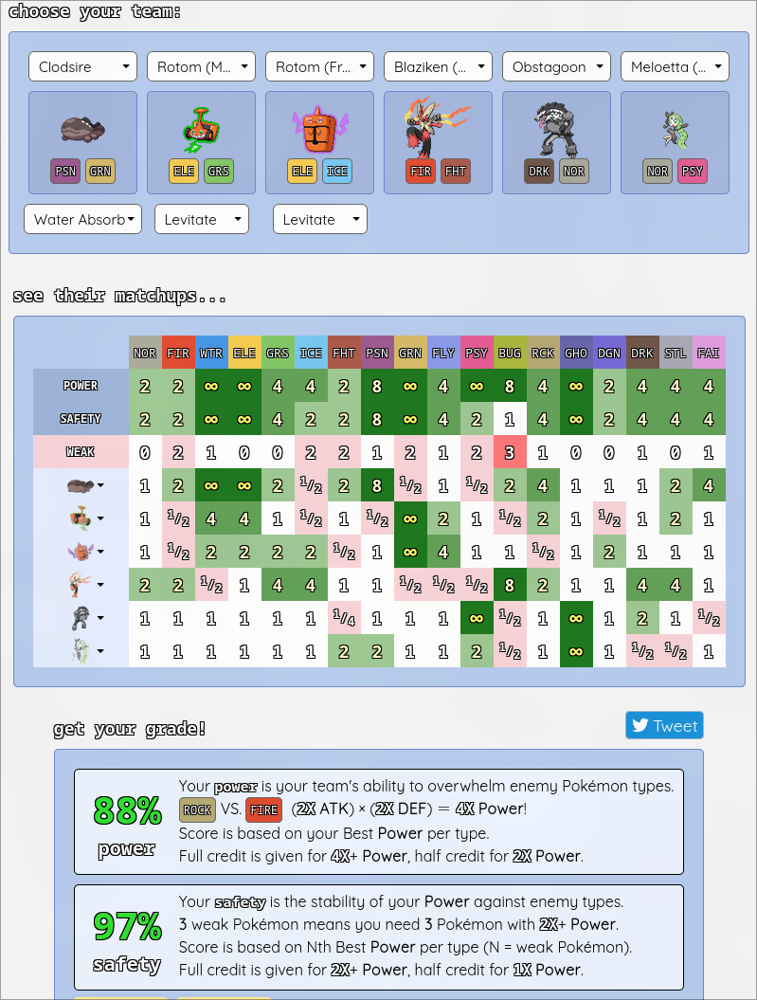

# Object Detection Model

## Making Predictions

In [10]:
def get_image_paths(folder_path):
    # Define common image extensions
    image_extensions = ['.jpg', '.jpeg', '.png', '.gif', '.bmp', '.tiff', '.webp']
    
    # List to store image paths
    image_paths = []
    
    # Get all files in the folder
    for file in os.listdir(folder_path):
        # Create full path
        full_path = os.path.join(folder_path, file)
        
        # Check if it's a file and has an image extension
        if os.path.isfile(full_path) and any(file.lower().endswith(ext) for ext in image_extensions):
            image_paths.append(full_path)
    
    return image_paths

In [11]:
blaziken_images = get_image_paths('/home/atvars/School/advanced_ai/Pokemon/object_det_images/blaziken_mega')
clodsire_images = get_image_paths('/home/atvars/School/advanced_ai/Pokemon/object_det_images/clodsire')
meloetta_images = get_image_paths('/home/atvars/School/advanced_ai/Pokemon/object_det_images/meloetta-aria')
obstagoon_images = get_image_paths('/home/atvars/School/advanced_ai/Pokemon/object_det_images/obstagoon')
rotom_frost_images = get_image_paths('/home/atvars/School/advanced_ai/Pokemon/object_det_images/rotom-frost')
rotom_mow_images = get_image_paths('/home/atvars/School/advanced_ai/Pokemon/object_det_images/rotom-mow')

In [13]:
# --- Configuration ---
MODEL_PATH = 'yolo_train/runs/detect/train/weights/best.pt'
CONFIDENCE_THRESHOLD = 0.25

# Load the trained YOLO model
try:
    model = YOLO(MODEL_PATH)
    print(f"Model loaded successfully from {MODEL_PATH}")
    # Get class names from the model
    class_names = model.names
    print(f"Model class names: {class_names}")
except Exception as e:
    print(f"Error loading model: {e}")
    exit()

# Generate distinct colors for each class
random.seed(42) # for reproducible colors
colors = {name: [random.randint(0, 255)/255.0 for _ in range(3)] for name in class_names.values()}
# Add a default color for potential missing classes
default_color = [0.5, 0.5, 0.5] # Gray

Model loaded successfully from yolo_train/runs/detect/train/weights/best.pt
Model class names: {0: 'blaziken-mega', 1: 'clodsire', 2: 'meloetta-aria', 3: 'obstagoon', 4: 'rotom-frost', 5: 'rotom-mow'}


In [20]:
def infer(model, image_path, confidence_threshold=0.25):
    """
    Perform inference on a single image using the YOLO model.
    
    Parameters:
    -----------
    model : YOLO
        The YOLO model instance
    image_path : str
        Path to the input image
    confidence_threshold : float
        Confidence threshold for filtering predictions
    
    Returns:
    --------
    results : list
        List of detected objects with their bounding boxes and class names
    """
    # Perform inference
    results = model.predict(source=image_path, conf=confidence_threshold)
    
    # Extract bounding boxes and class names
    detections = []
    for result in results:
        for box in result.boxes.data.tolist():
            x1, y1, x2, y2, conf, cls = box
            class_name = class_names[int(cls)]
            detections.append({
                'bbox': [x1, y1, x2, y2],
                'confidence': conf,
                'class_name': class_name
            })
    
    return detections

In [ ]:
blaziken_detections = [infer(model, img_path, CONFIDENCE_THRESHOLD) for img_path in blaziken_images]
clodsire_detections = [infer(model, img_path, CONFIDENCE_THRESHOLD) for img_path in clodsire_images]
meloetta_detections = [infer(model, img_path, CONFIDENCE_THRESHOLD) for img_path in meloetta_images]
obstagoon_detections = [infer(model, img_path, CONFIDENCE_THRESHOLD) for img_path in obstagoon_images]
rotom_frost_detections = [infer(model, img_path, CONFIDENCE_THRESHOLD) for img_path in rotom_frost_images]
rotom_mow_detections = [infer(model, img_path, CONFIDENCE_THRESHOLD) for img_path in rotom_mow_images]

In [24]:
def visualize(image_path, detections, class_names, colors):
    """
    Visualize the detected objects on the image.
    
    Parameters:
    -----------
    image_path : str
        Path to the input image
    detections : list
        List of detected objects with their bounding boxes and class names
    class_names : dict
        Dictionary mapping class IDs to class names
    colors : dict
        Dictionary mapping class names to colors
    
    Returns:
    --------
    None
    """
    # Load the image
    img = Image.open(image_path)
    
    # Create a figure and axis for plotting
    fig, ax = plt.subplots(1, figsize=(12, 9))
    
    # Display the image
    ax.imshow(img)
    
    # Draw bounding boxes and labels
    for detection in detections:
        bbox = detection['bbox']
        conf = detection['confidence']
        class_name = detection['class_name']
        
        # Draw rectangle around the detected object
        rect = patches.Rectangle((bbox[0], bbox[1]), bbox[2] - bbox[0], bbox[3] - bbox[1],
                                 linewidth=2, edgecolor=colors.get(class_name, default_color), facecolor='none')
        ax.add_patch(rect)
        
        # Add label with confidence score
        ax.text(bbox[0], bbox[1], f"{class_name} ({conf:.2f})", fontsize=12,
                color='white', bbox=dict(facecolor=colors.get(class_name, default_color), alpha=0.5))
    
    # Hide axes
    ax.axis('off')
    
    # Show the plot
    plt.show()

## Mega Blaziken Detections

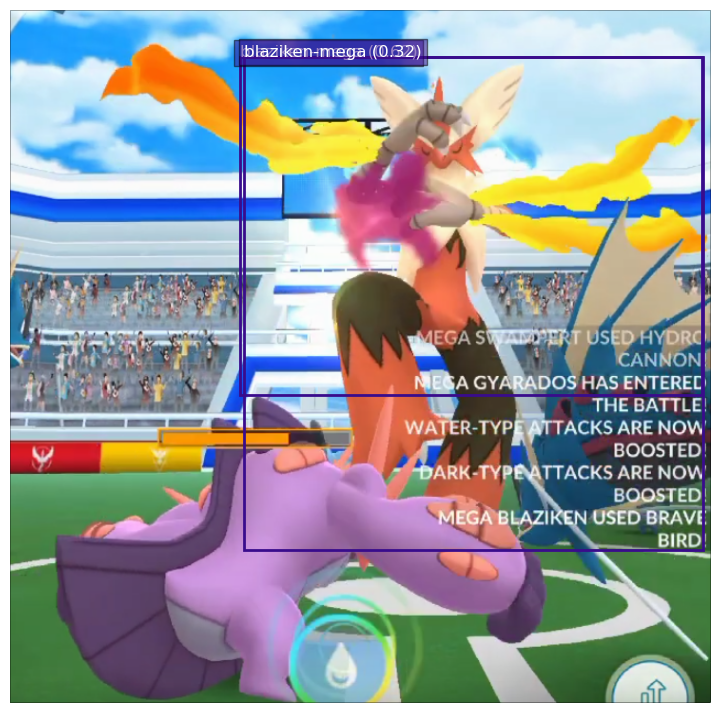

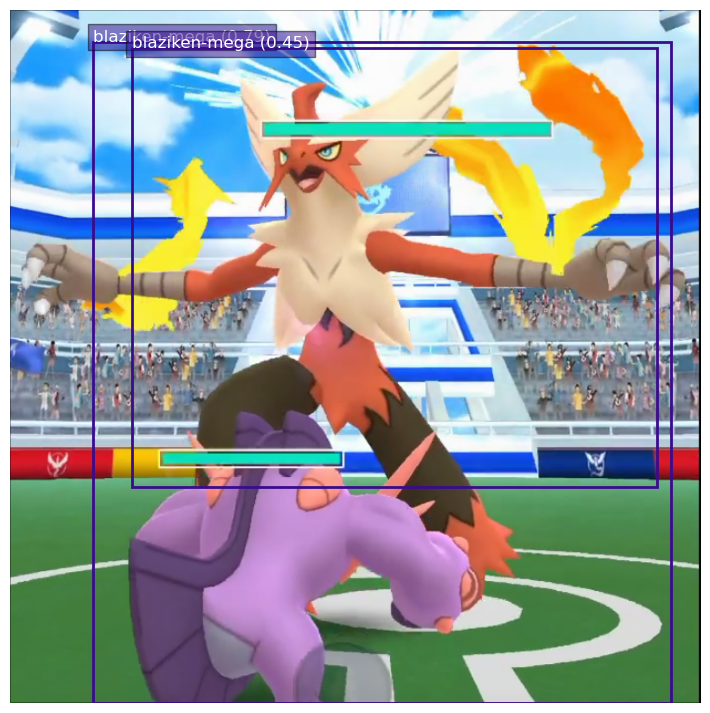

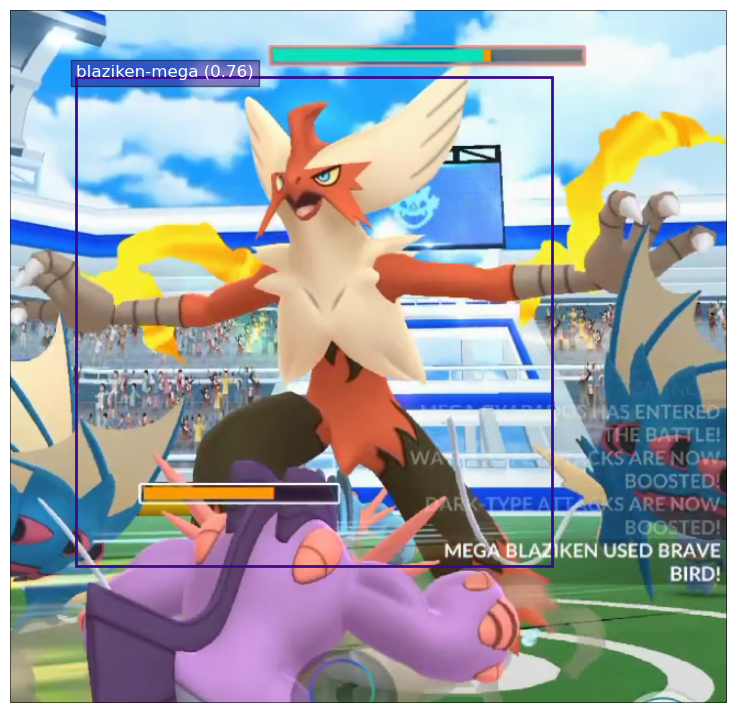

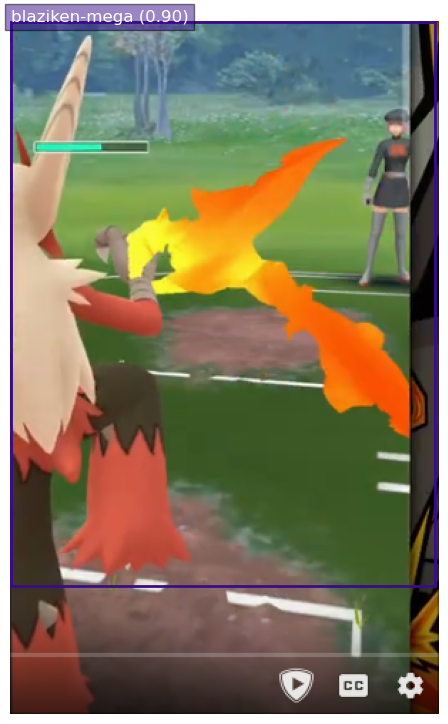

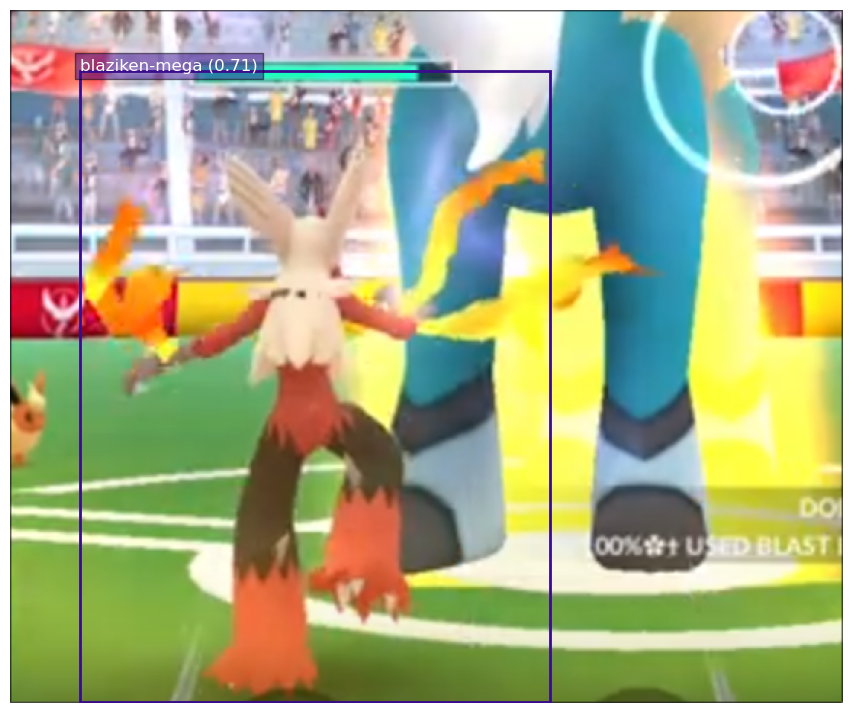

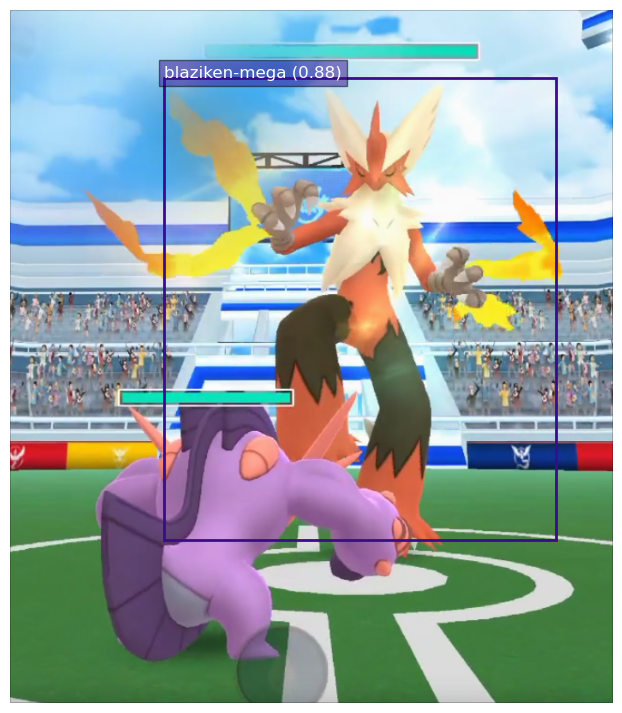

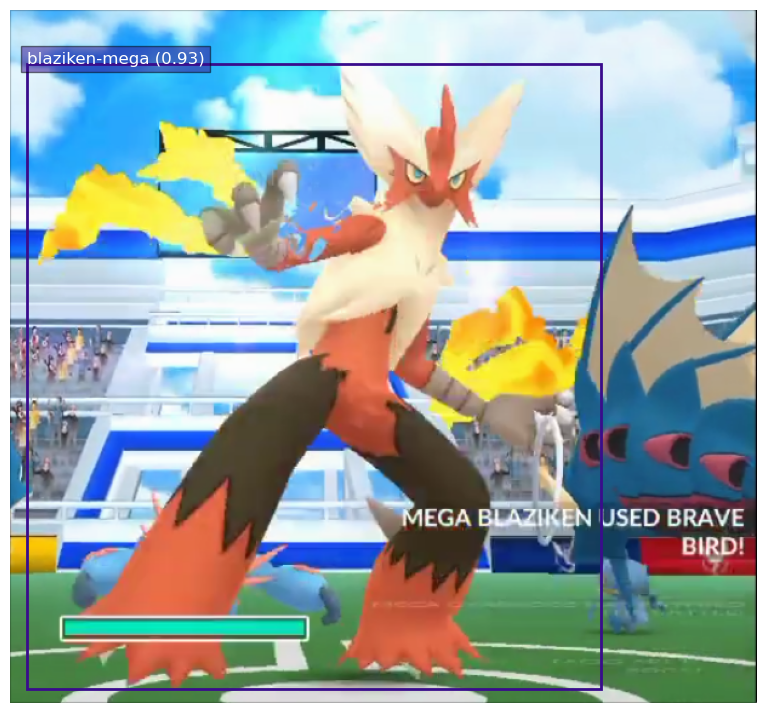

In [26]:
for img_path, detections in zip(blaziken_images, blaziken_detections):
    visualize(img_path, detections, class_names, colors)

## Clodsire Predictions

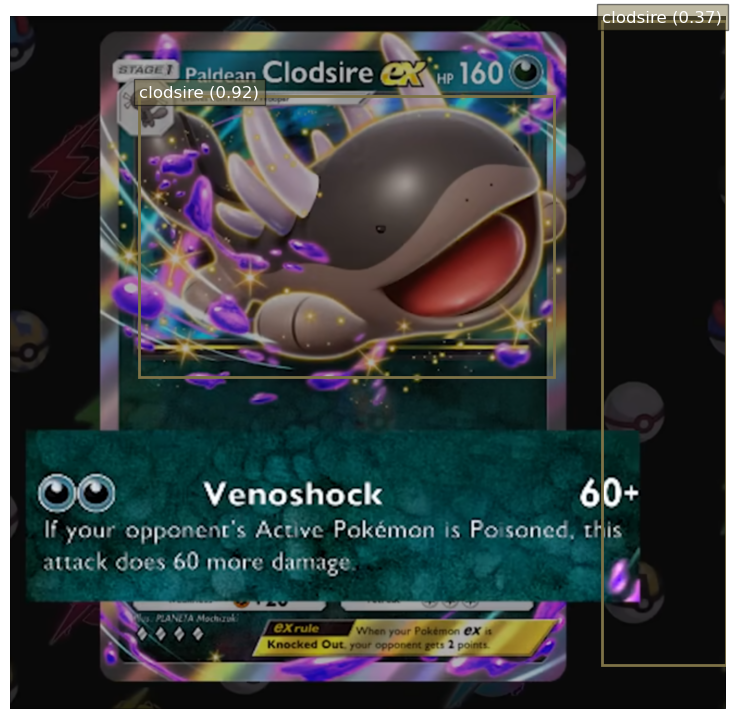

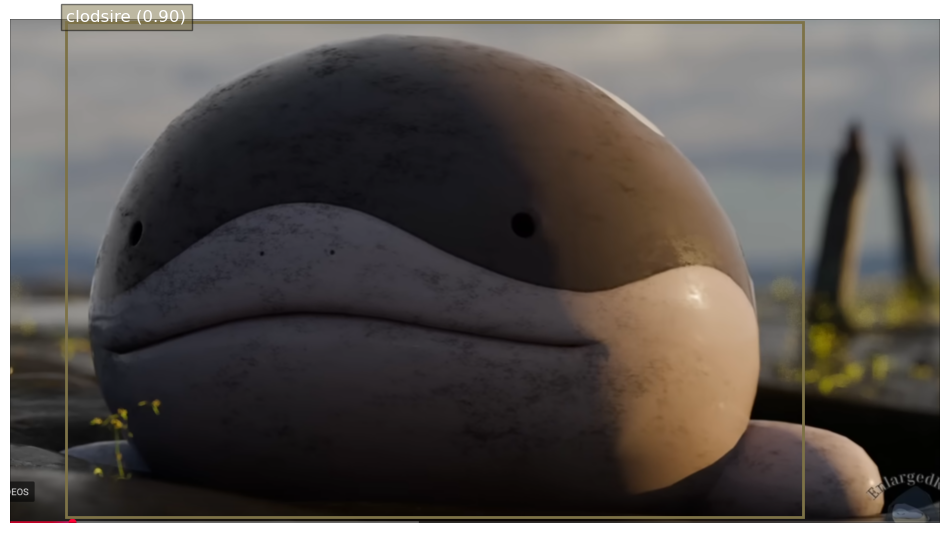

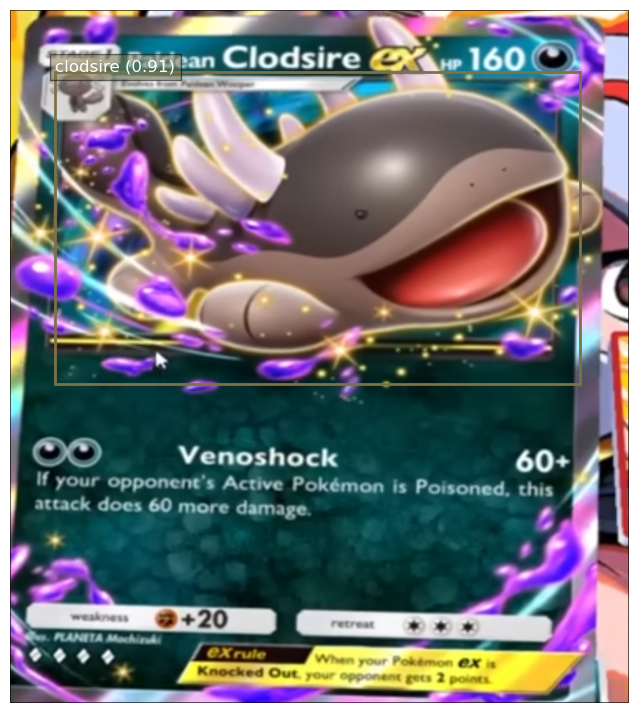

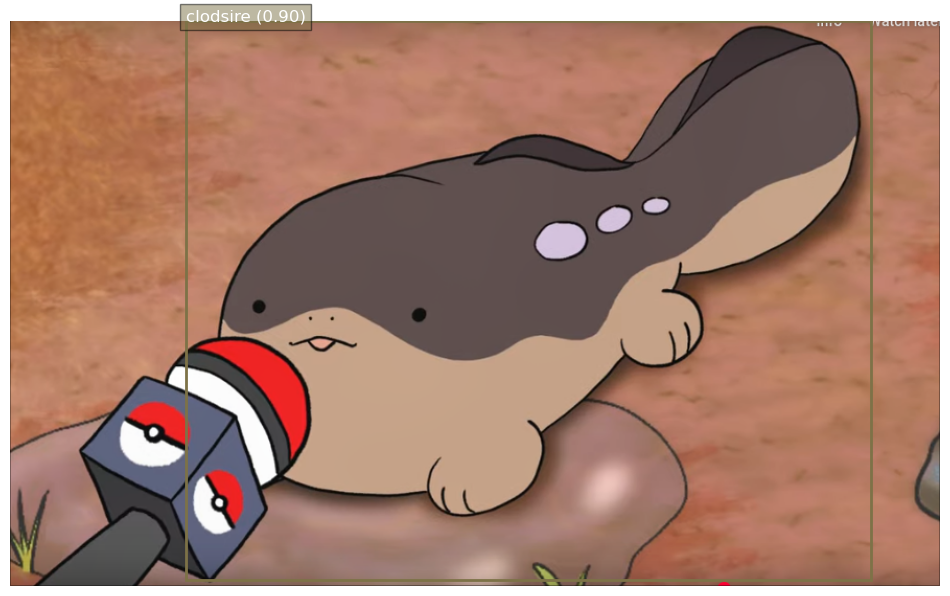

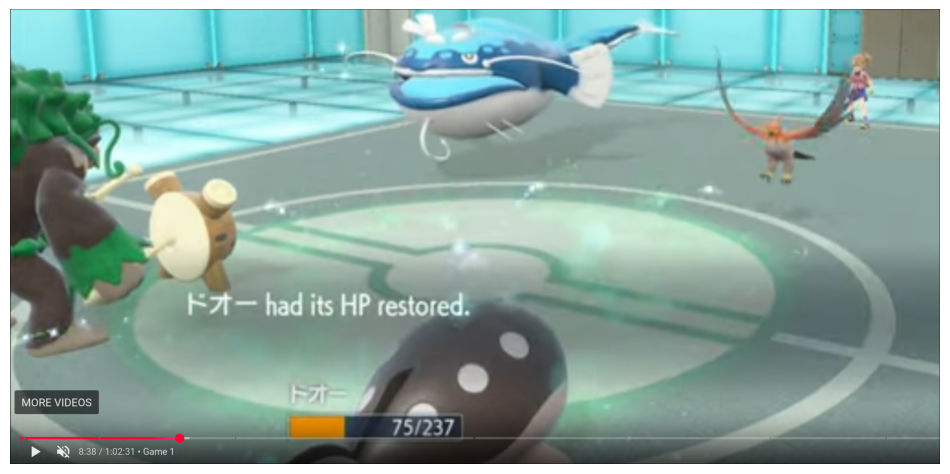

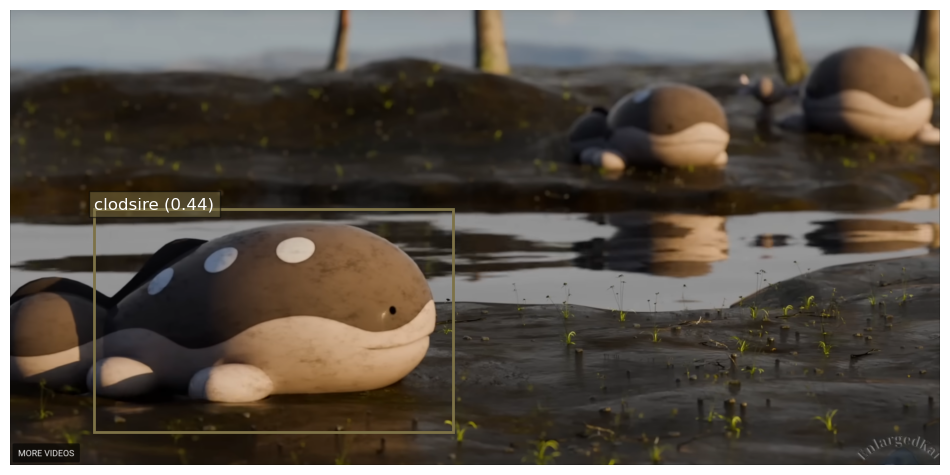

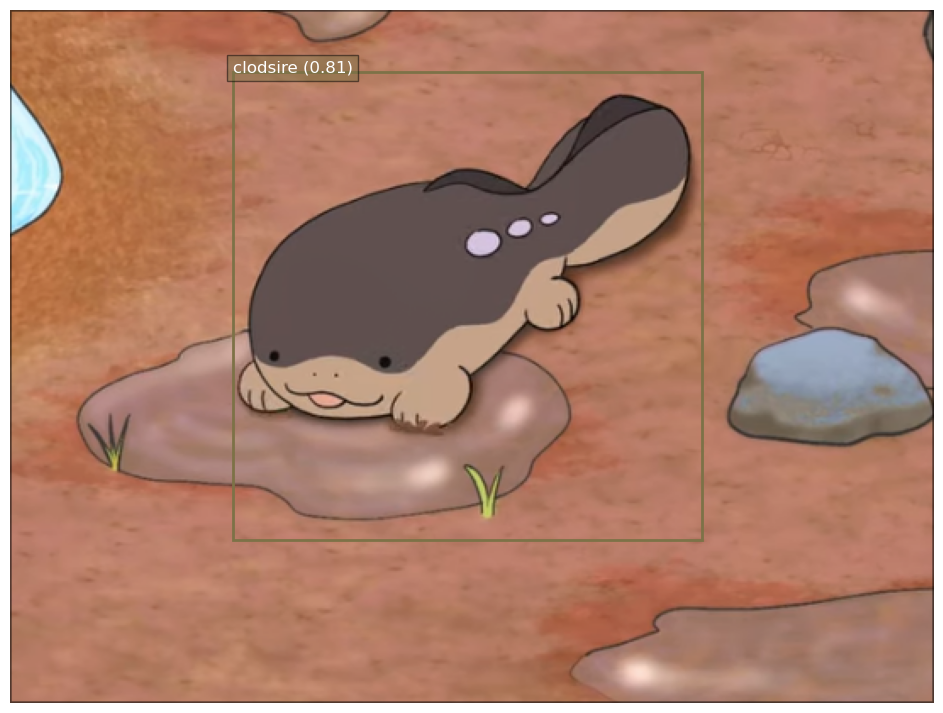

[None, None, None, None, None, None, None]

In [27]:
[visualize(img_path, detections, class_names, colors) for img_path, detections in zip(clodsire_images, clodsire_detections)]

## Meloetta (Aria Form) Predictions

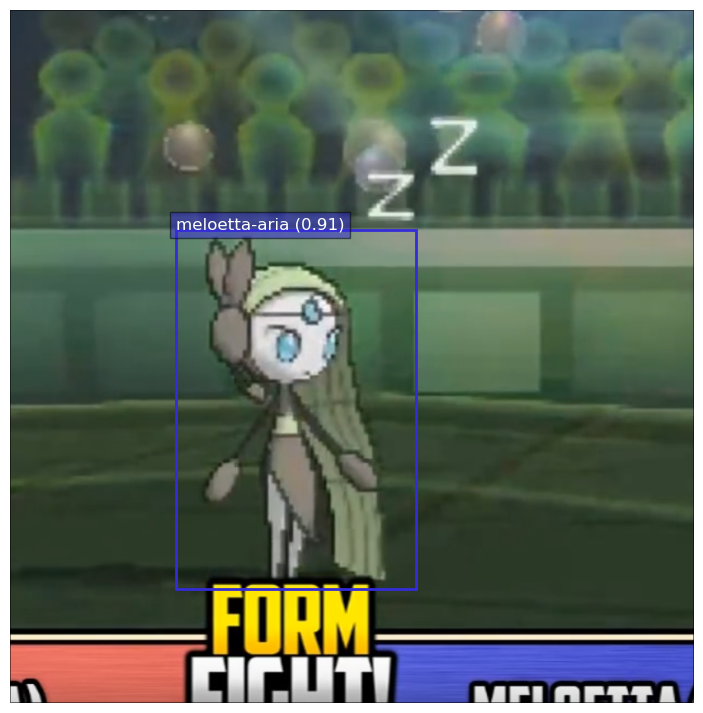

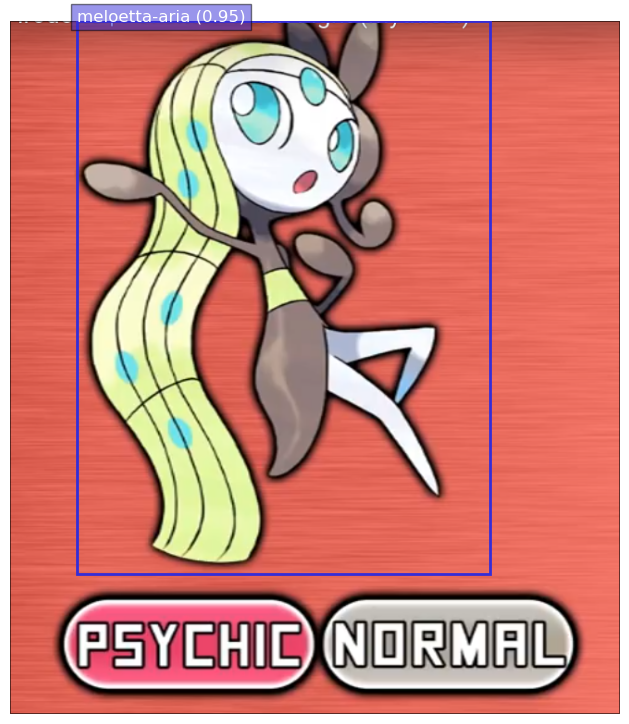

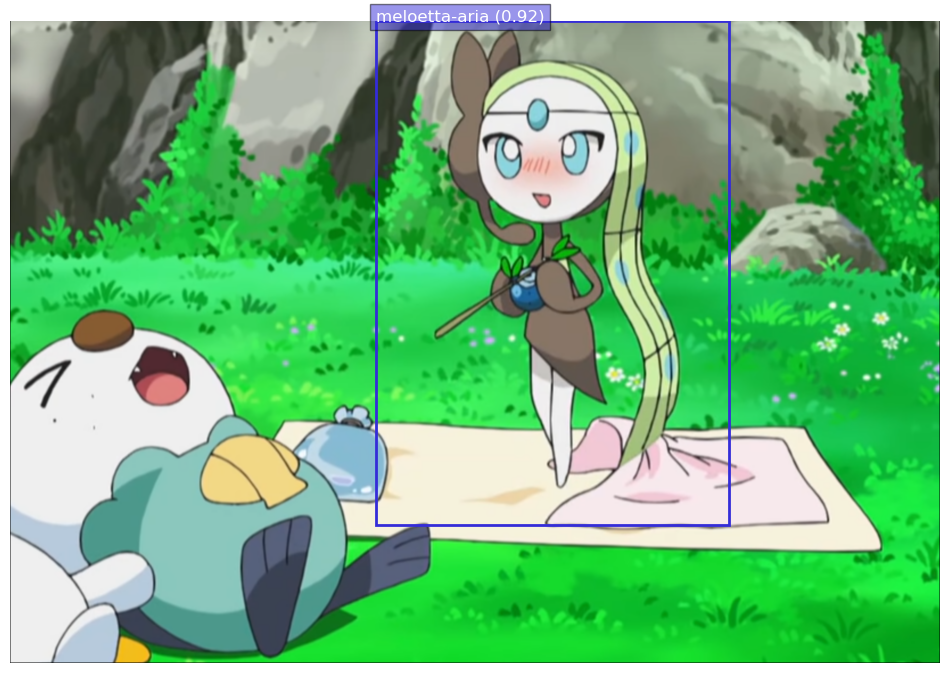

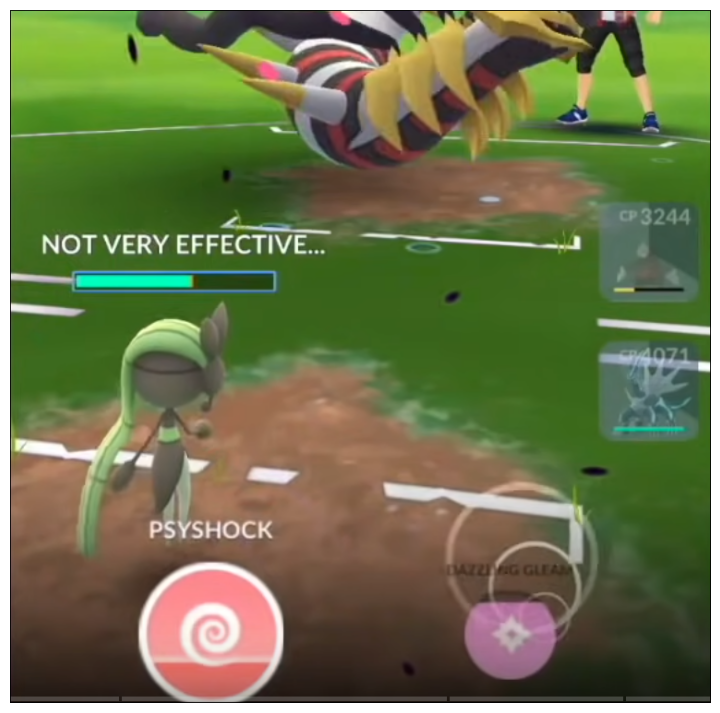

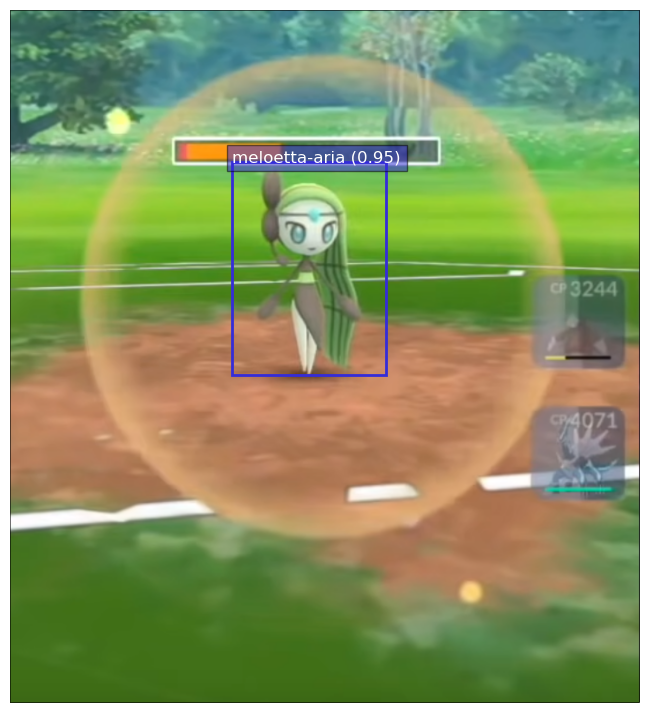

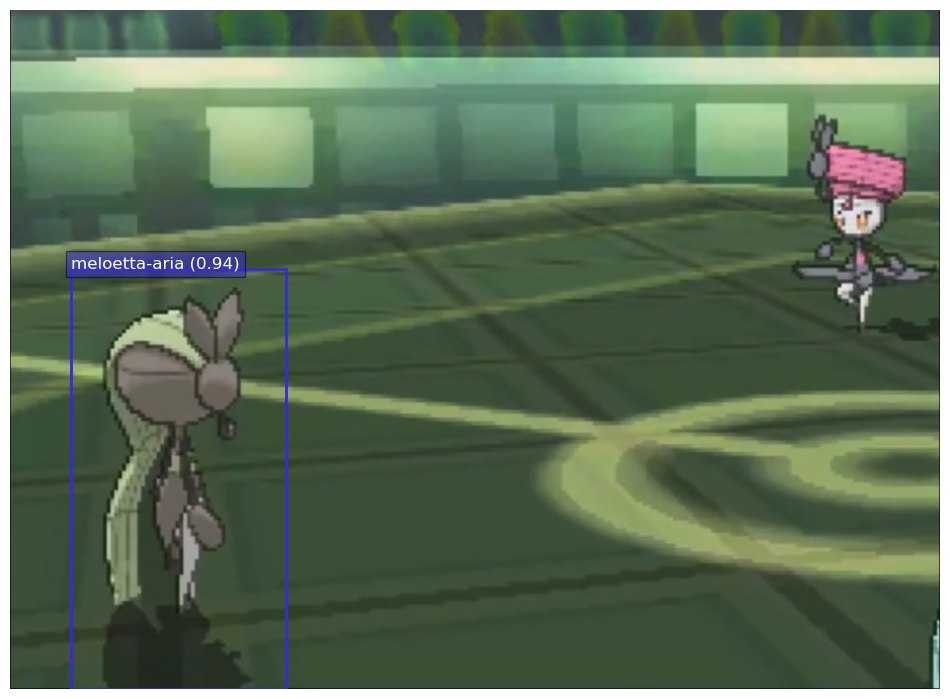

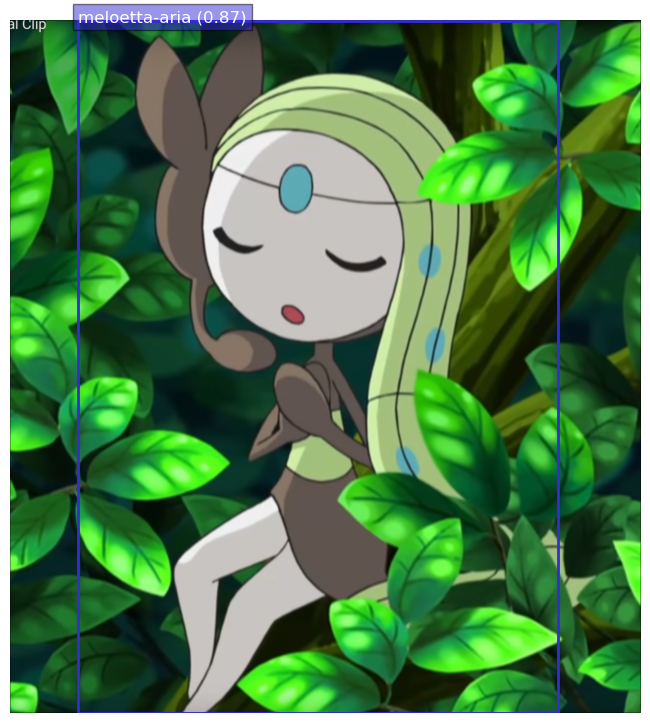

[None, None, None, None, None, None, None]

In [28]:
[visualize(img_path, detections, class_names, colors) for img_path, detections in zip(meloetta_images, meloetta_detections)]

# Obstagoon Predictions

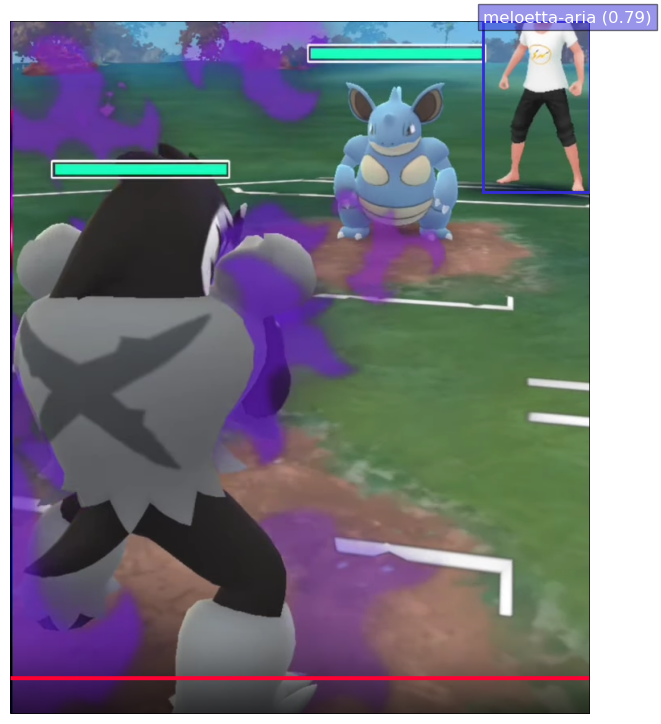

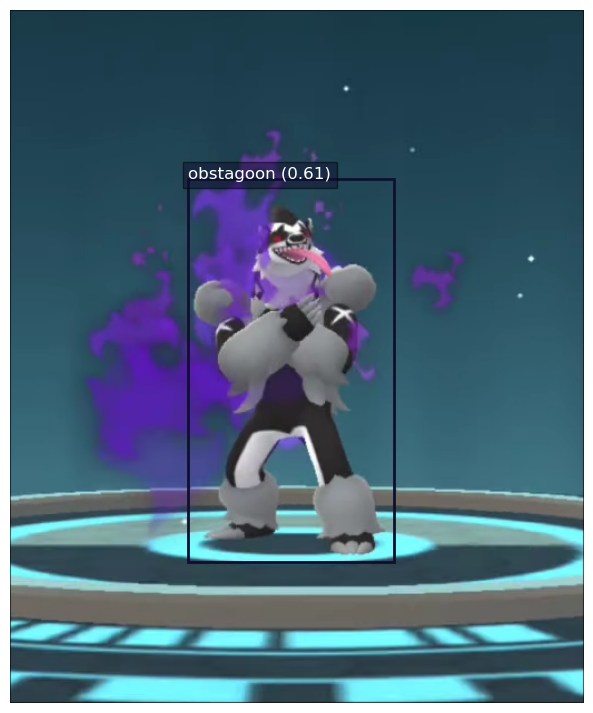

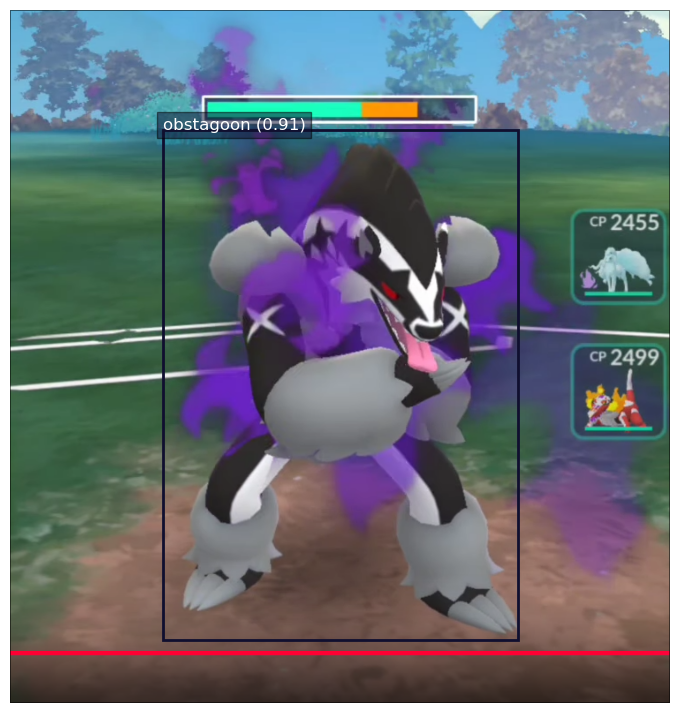

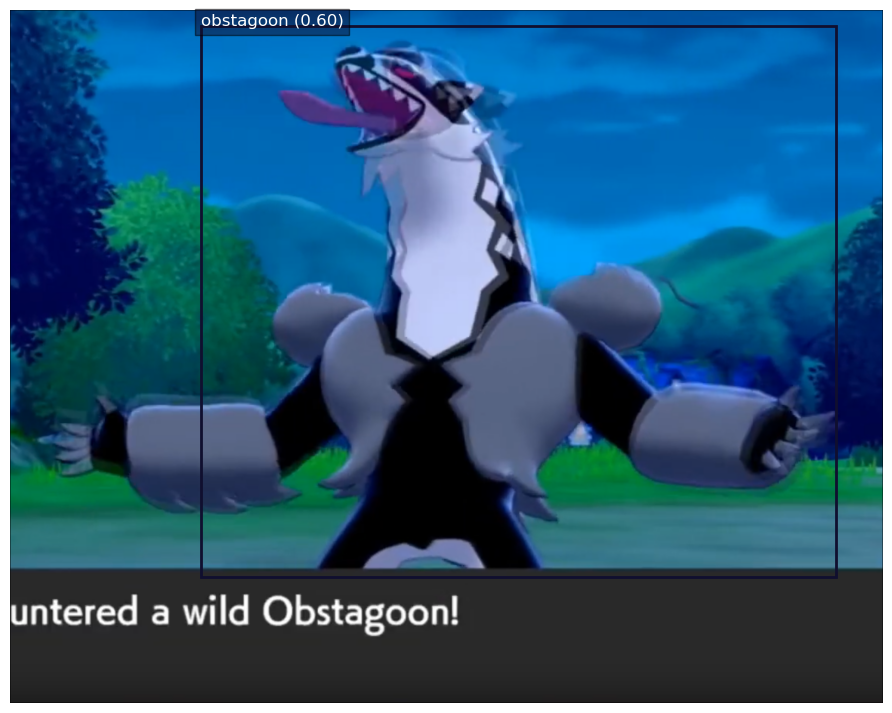

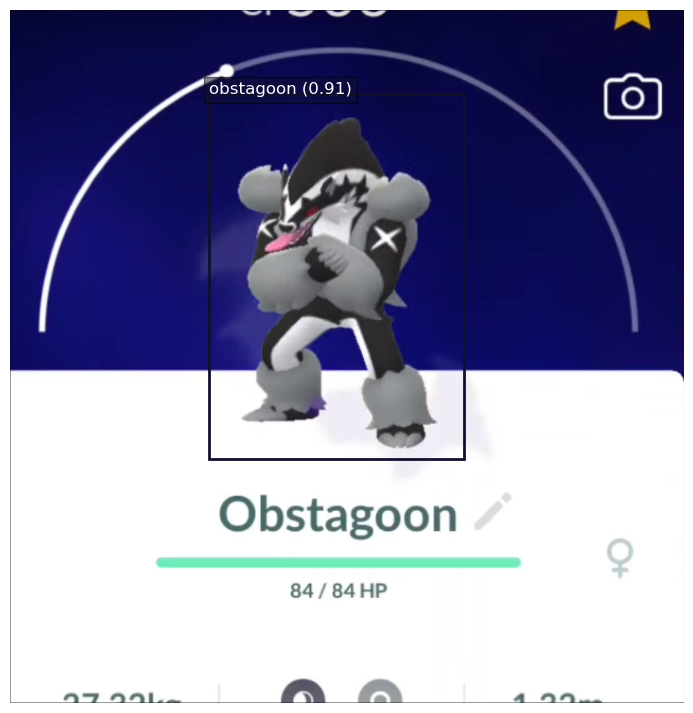

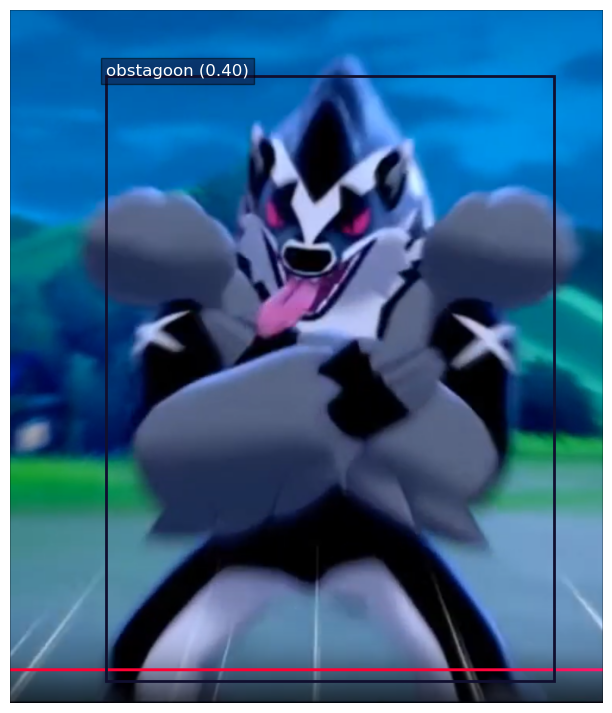

[None, None, None, None, None, None]

In [29]:
[visualize(img_path, detections, class_names, colors) for img_path, detections in zip(obstagoon_images, obstagoon_detections)]

## Frost Rotom Predictions

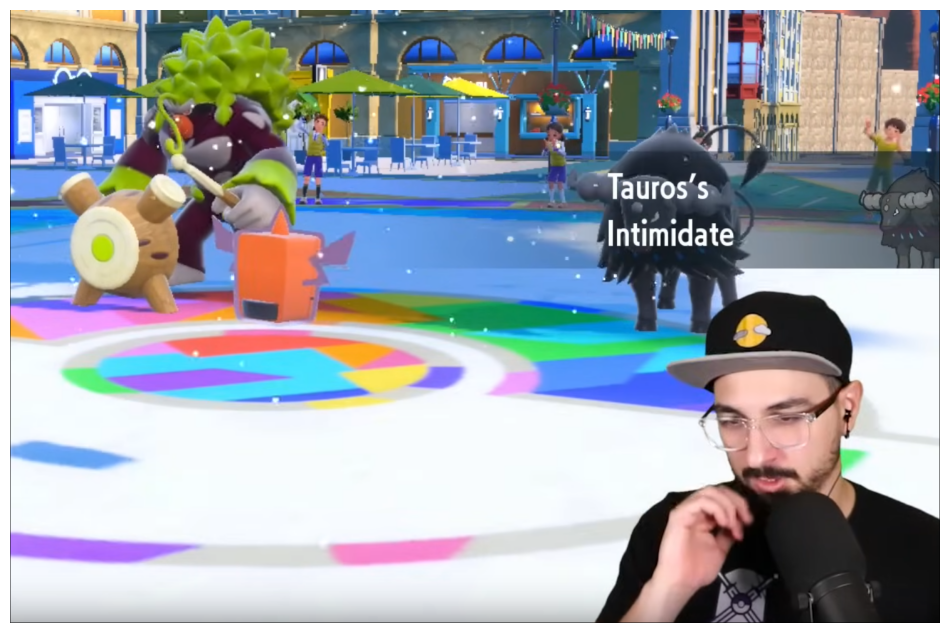

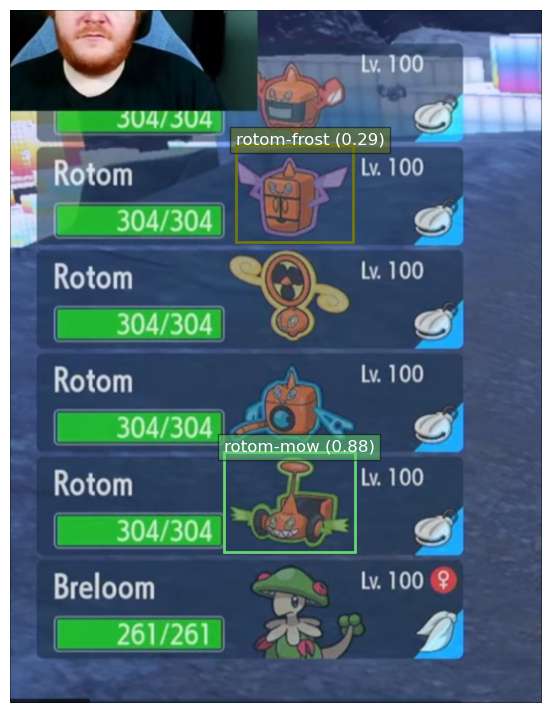

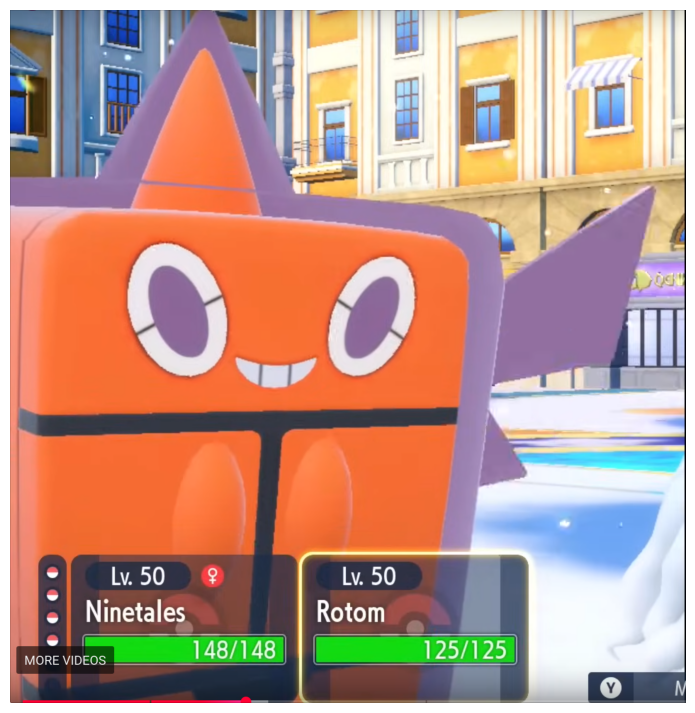

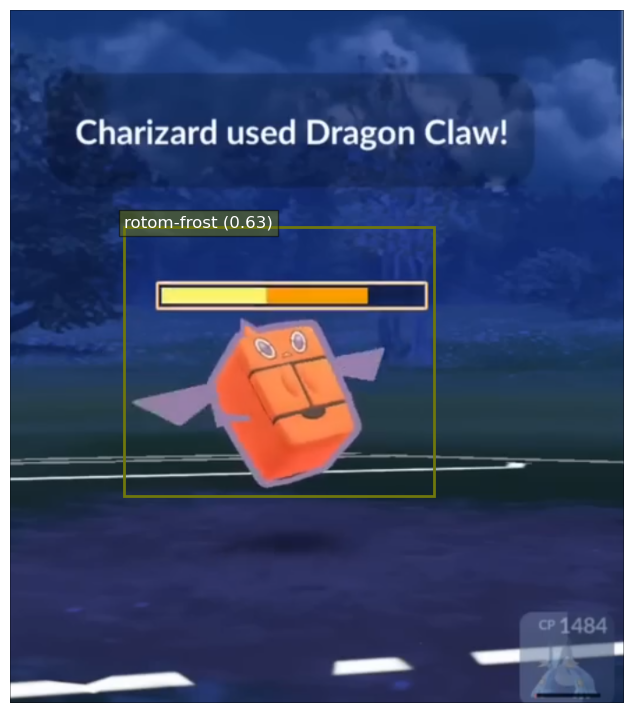

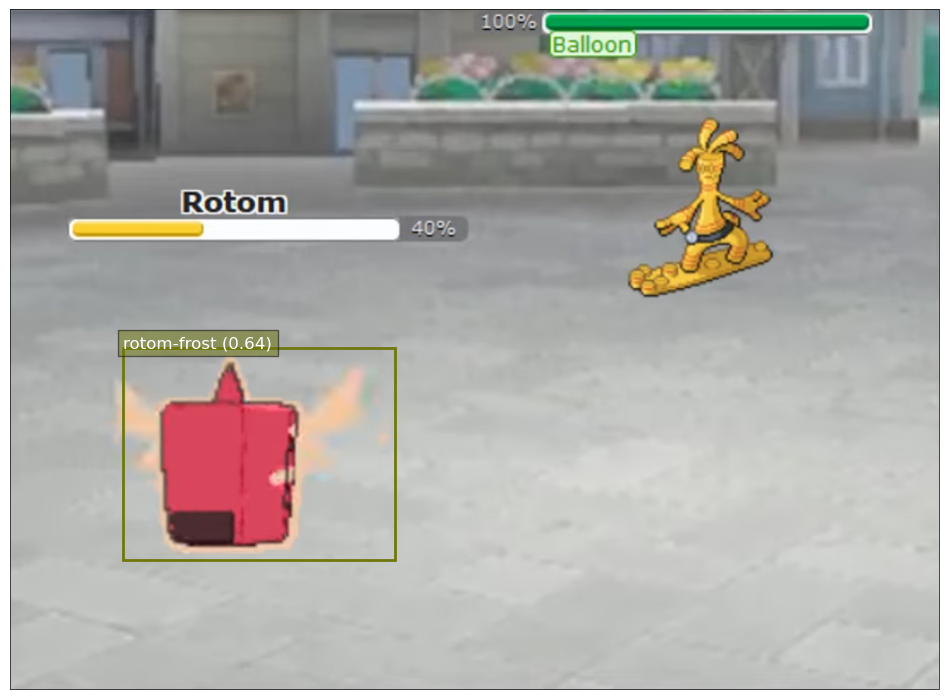

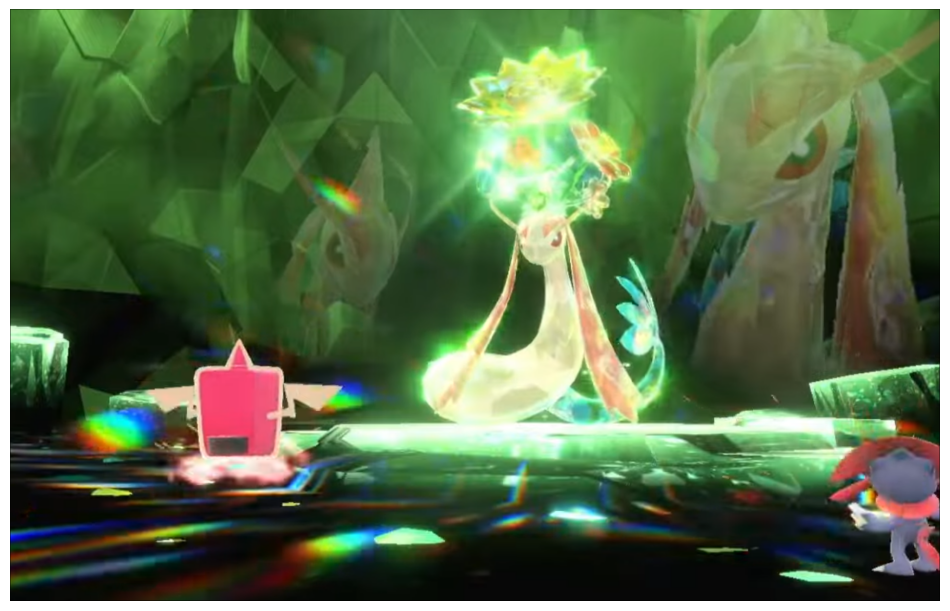

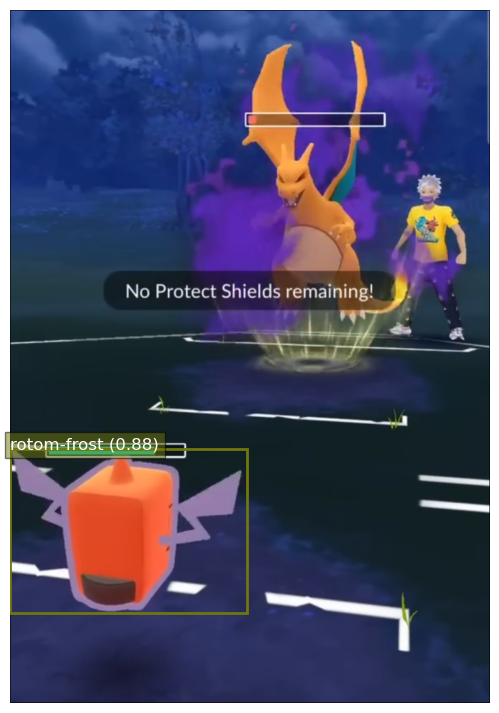

[None, None, None, None, None, None, None]

In [30]:
[visualize(img_path, detections, class_names, colors) for img_path, detections in zip(rotom_frost_images, rotom_frost_detections)]

## Mow Rotom Predictions

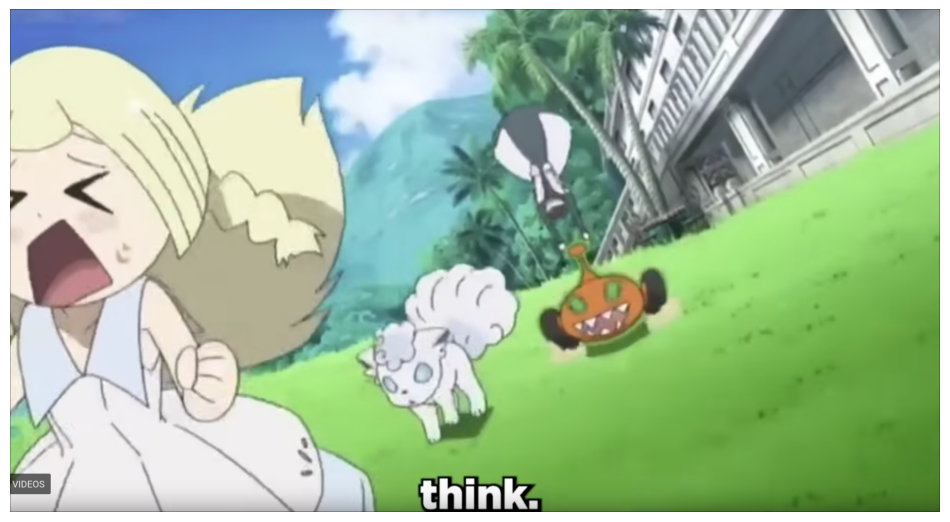

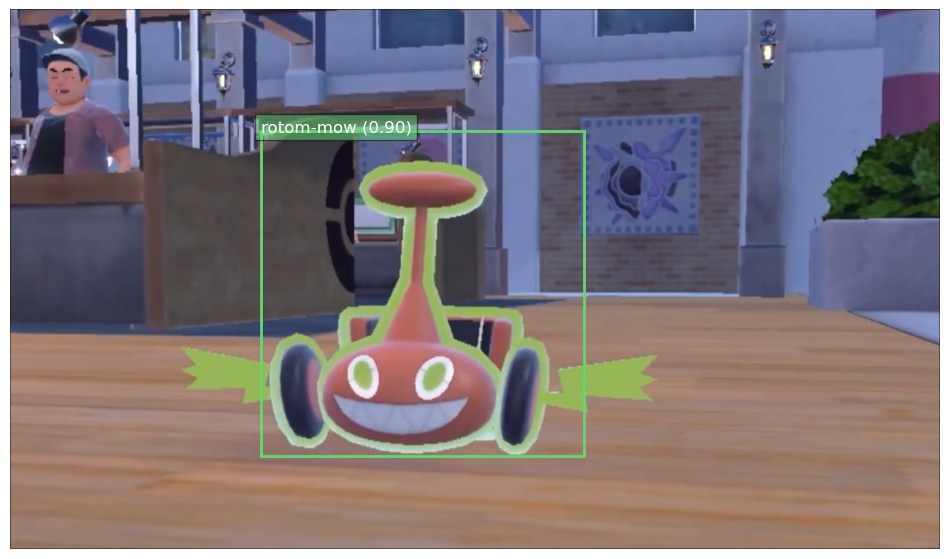

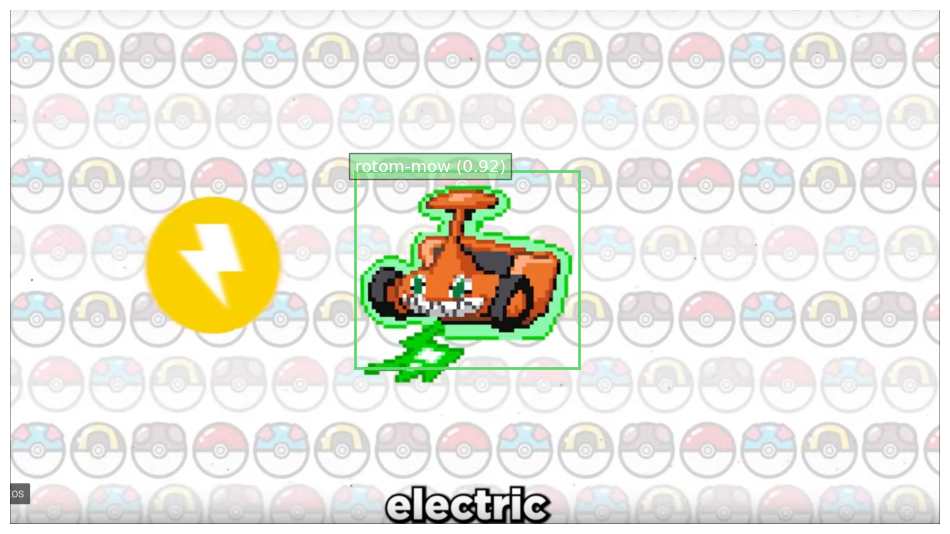

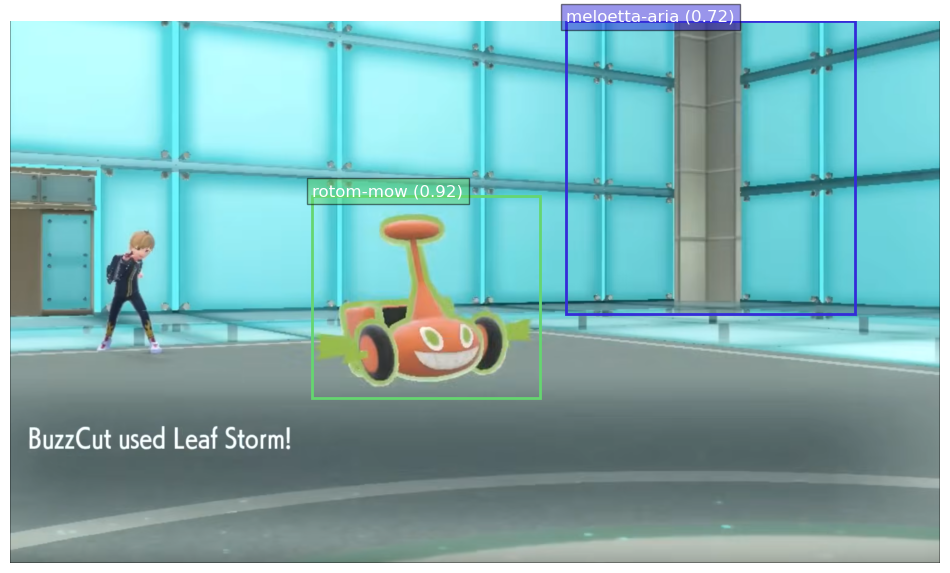

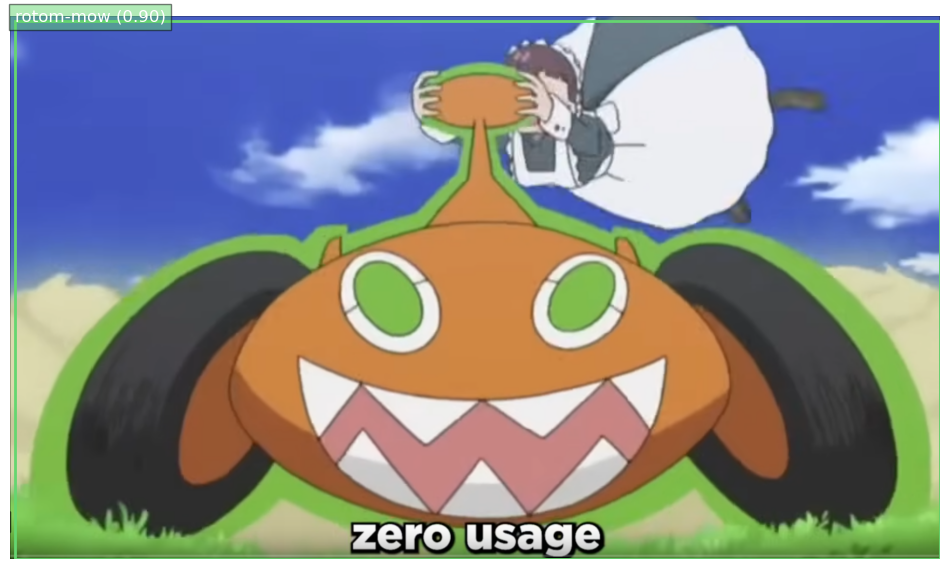

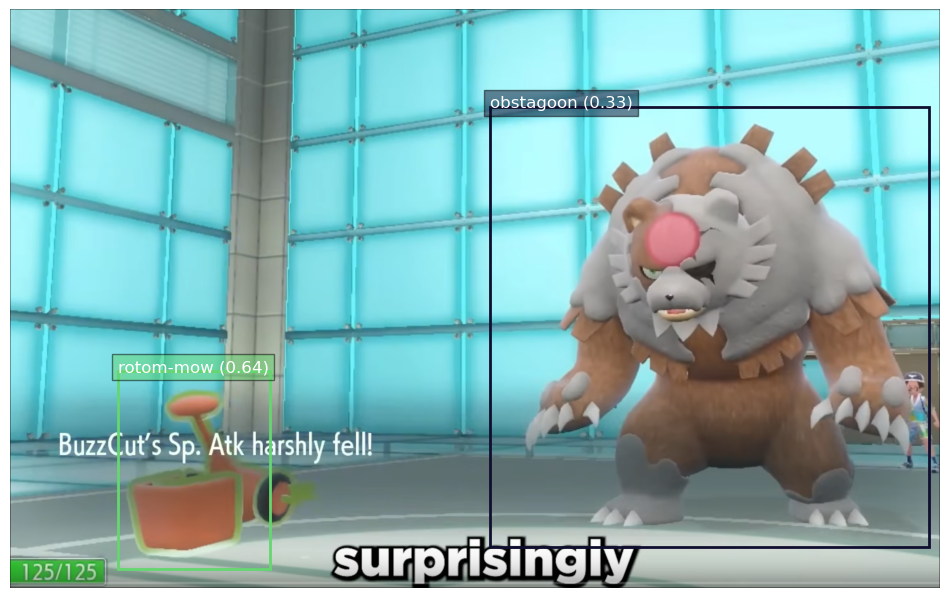

[None, None, None, None, None, None]

In [31]:
[visualize(img_path, detections, class_names, colors) for img_path, detections in zip(rotom_mow_images, rotom_mow_detections)]